In [1]:
library(Seurat)
library(ggplot2)
library(dplyr)
library(ggthemes)
library(plyr)

Attaching SeuratObject


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


------------------------------------------------------------------------------

You have loaded plyr after dplyr - this is likely to cause problems.
If you need functions from both plyr and dplyr, please load plyr first, then dplyr:
library(plyr); library(dplyr)

------------------------------------------------------------------------------


Attaching package: ‘plyr’


The following objects are masked from ‘package:dplyr’:

    arrange, count, desc, failwith, id, mutate, rename, summarise,
    summarize




In [2]:
setwd("/data/work/Analysis")

In [3]:
rds=Sys.glob("./*.rds")

In [25]:
objlist=apply(as.matrix(rds),1,FUN = function(xx){readRDS(xx)})

In [26]:
objlist

[[1]]
An object of class Seurat 
41771 features across 9904 samples within 2 assays 
Active assay: Protein (321 features, 321 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, umap, apca, pumap

[[2]]
An object of class Seurat 
38424 features across 10321 samples within 2 assays 
Active assay: Protein (305 features, 305 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, umap, apca, pumap

[[3]]
An object of class Seurat 
41419 features across 10017 samples within 2 assays 
Active assay: Protein (341 features, 341 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, umap, apca, pumap

[[4]]
An object of class Seurat 
26227 features across 10146 samples within 2 assays 
Active assay: Protein (324 features, 324 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, umap, apca, pumap

[[5]]
An object of class Seurat 
36147 features across 99

In [27]:
mer=merge(objlist[[1]],objlist[seq(2,19,1)],add.cell.ids = sub(".rds","",sub(".*/","",rds)))

In [28]:
mer@active.assay="RNA"

In [29]:
mer$sample=sub("_.*","",rownames(mer@meta.data))

In [30]:
library(harmony)

Loading required package: Rcpp



In [6]:
mer@active.assay

[1] "RNA"

In [13]:
#mer=NormalizeData(mer,verbose = F)
#mer=FindVariableFeatures(mer,verbose=F)
#mer=ScaleData(mer,verbose=F)
#mer=RunPCA(mer)
library(harmony)
#mer=RunHarmony(mer,group.by.vars = "sample")
mer=RunHarmony(mer,group.by.vars = c("sample","conditions"),lambda=c(1,1))
mer=RunUMAP(mer,reduction = "harmony",dims = 1:15)
mer=FindNeighbors(mer,reduction="harmony",dims = 1:5)
mer=FindClusters(mer,resolution=0.3)

Transposing data matrix

Warning message:
“did not converge in 25 iterations”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 7873950)”
Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 7873950)”
Harmony 1/10

Harmony 2/10

Harmony converged after 2 iterations

Warning message:
“Invalid name supplied, making object name syntactically valid. New object name is Seurat..ProjectDim.RNA.harmony; see ?make.names for more details on syntax validity”
Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
09:08:35 UMAP embedding parameters a = 0.9922 b = 1.112

09:08:35 Read 157479 rows and found 15 numeric columns

09:08:35 Using Annoy for neighbor search, n_neighbors = 30

09:08:35 Building Annoy index with metric = cosine, n_trees = 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 157479
Number of edges: 4169360

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9215
Number of communities: 7
Elapsed time: 148 seconds


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



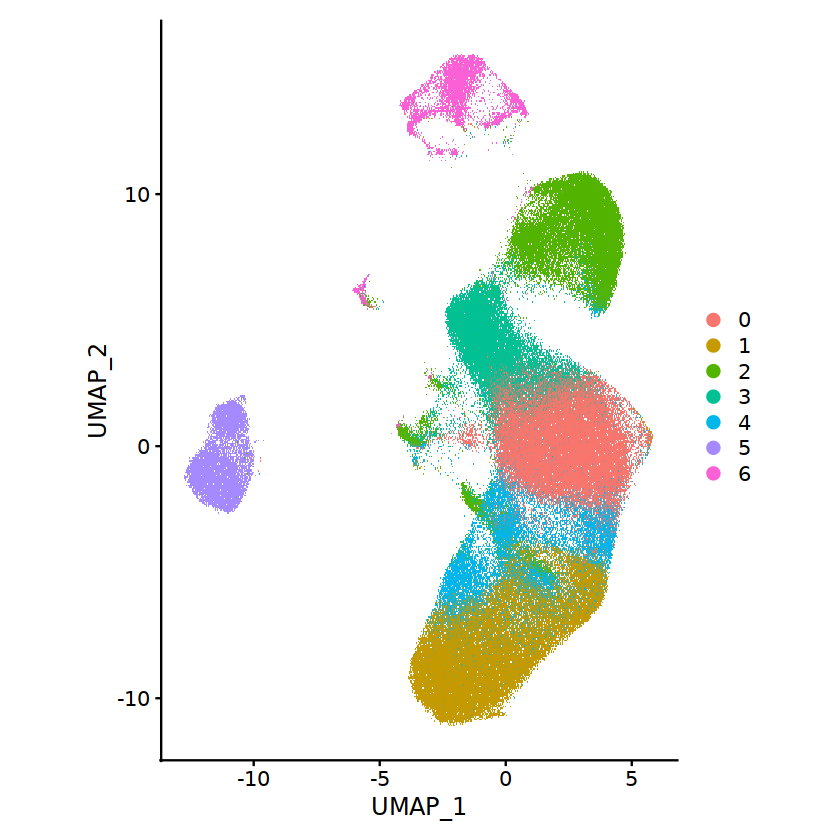

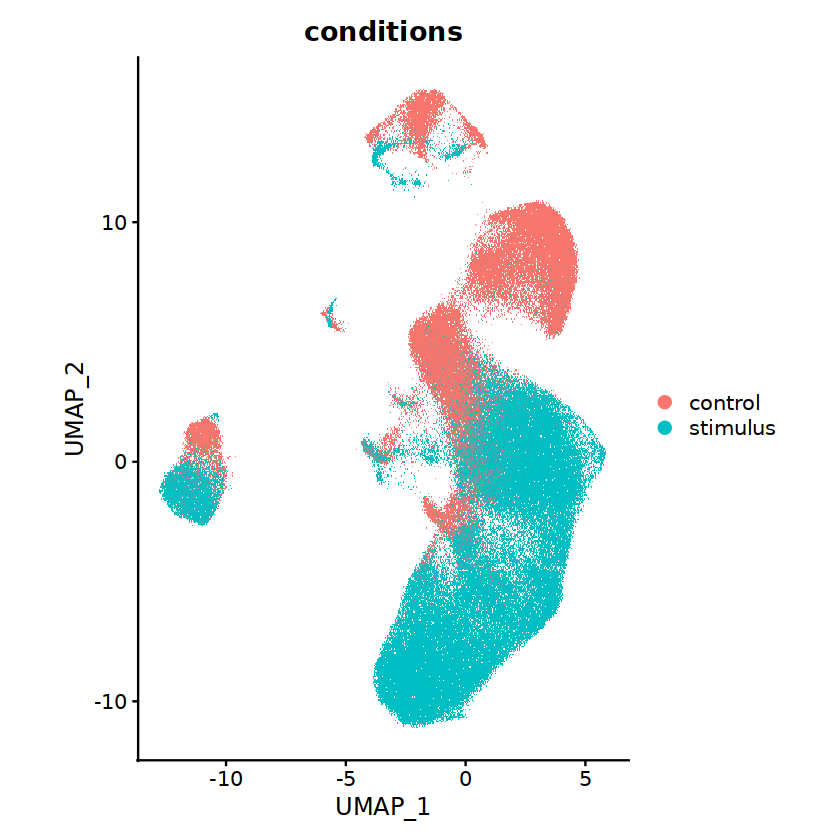

In [15]:
DimPlot(mer)+coord_fixed()
DimPlot(mer,group.by="conditions")+coord_fixed()

In [3]:
#saveRDS(mer,"filter.merge.rds")
mer=readRDS("filter.merge.rds")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



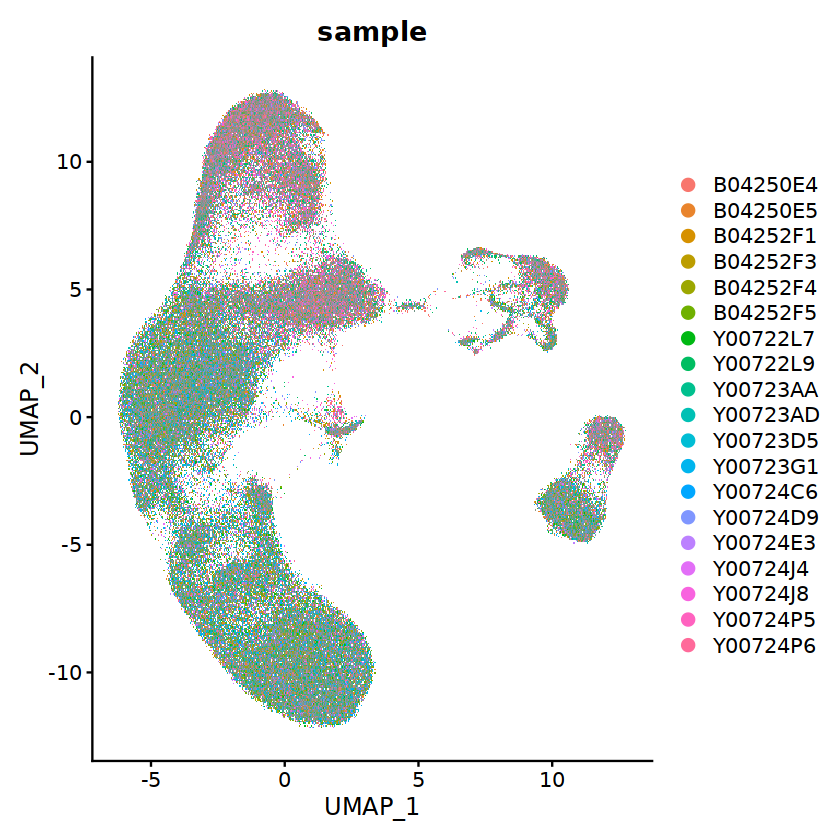

In [4]:
DimPlot(mer,group.by="sample")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



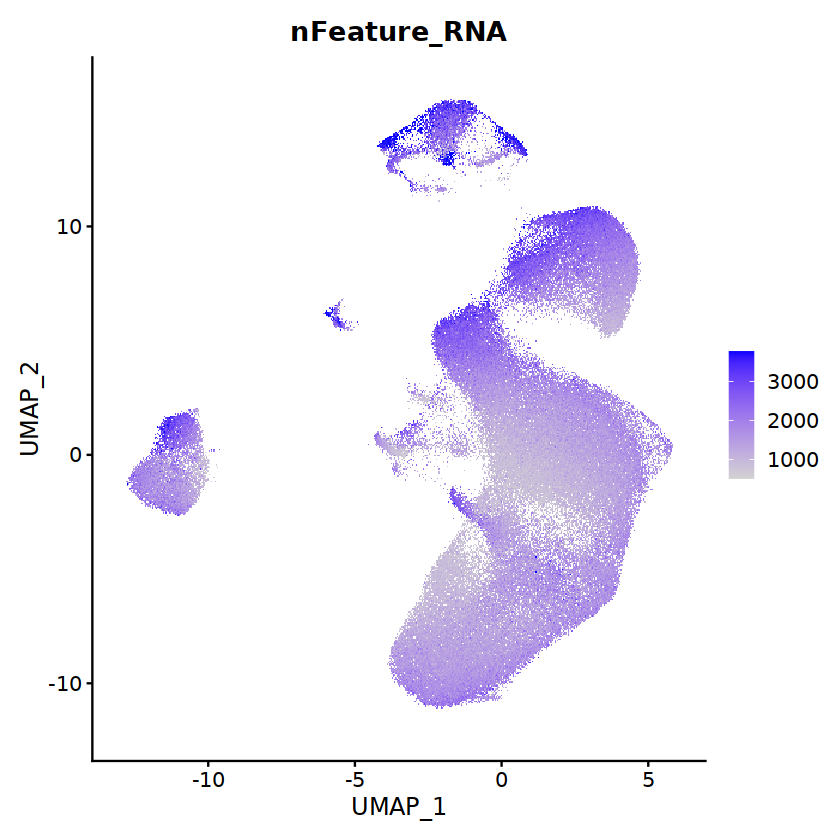

In [17]:
FeaturePlot(mer,"nFeature_RNA",max.cutoff="q99")

Warning message:
“Could not find CD8-Hu in the default search locations, found in Protein assay instead”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



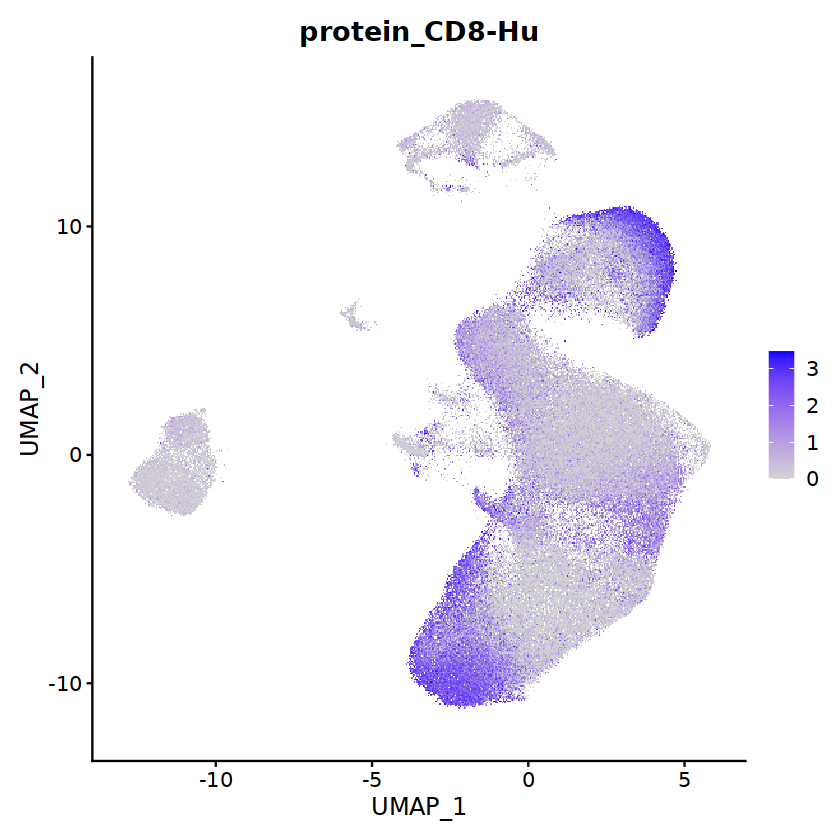

In [19]:
FeaturePlot(mer,"CD8-Hu",max.cutoff="q99",order=T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



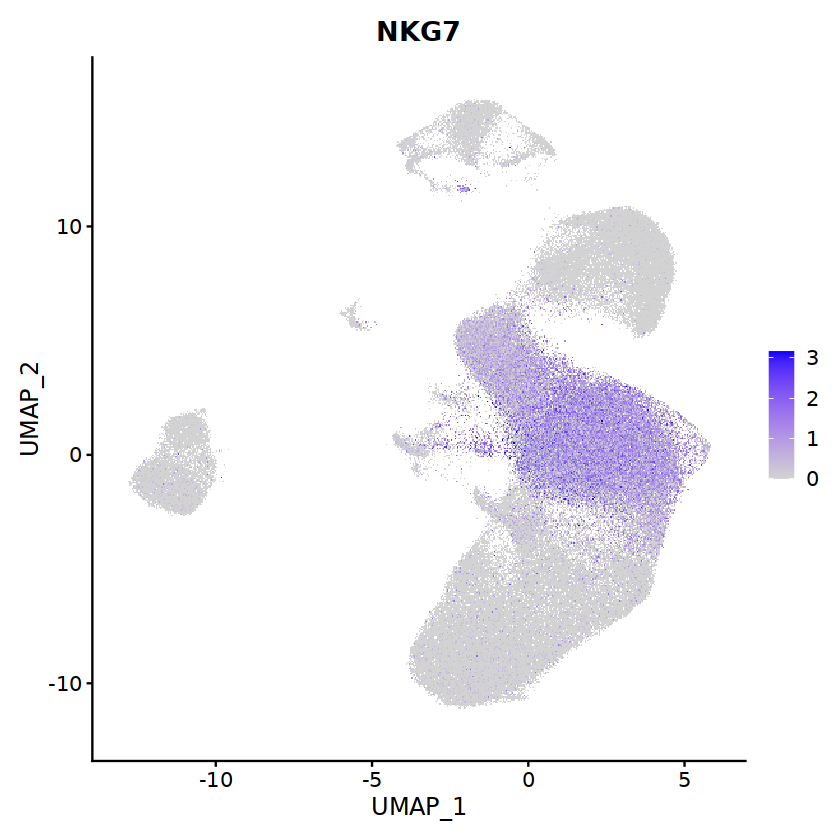

In [22]:
FeaturePlot(mer,"NKG7",max.cutoff="q99",order=T)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



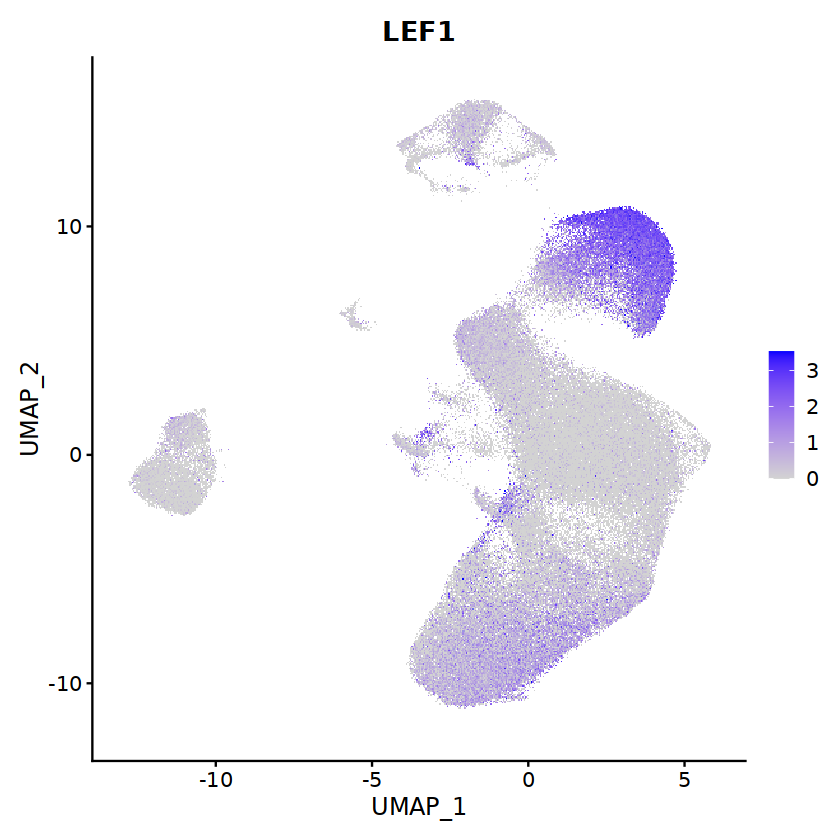

In [21]:
FeaturePlot(mer,"LEF1",max.cutoff="q99",order=T)

In [ ]:
"CD8-Hu","CD4-Hu-RPA-T4","CD16-Hu","CD56-Hu-5-1H11","KLRG1-Hu"

In [55]:
saveRDS(mer,"merge.rds")

Warning message:
“Removed 396 rows containing non-finite values (`stat_ydensity()`).”


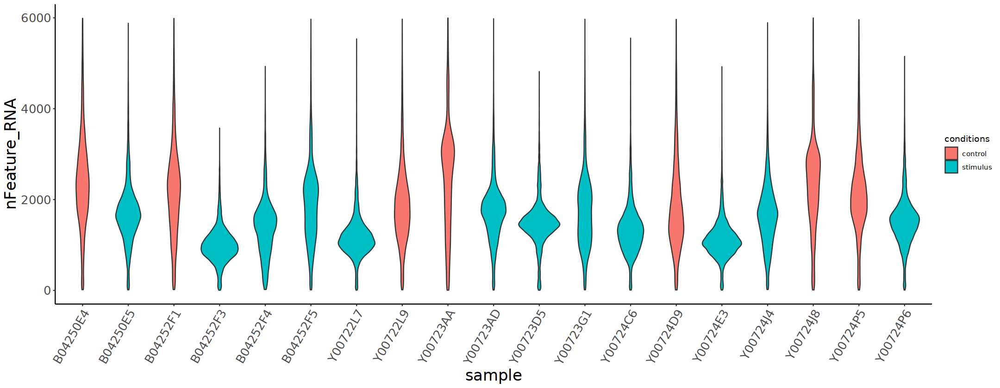

In [53]:
options(repr.plot.width=18)
ggplot(as.data.frame(mer@meta.data),aes(x=sample,y=nFeature_RNA,fill=conditions))+geom_violin()+theme_classic()+
theme(axis.text.x=element_text(size=15,angle=60,hjust=1),axis.title=element_text(size=20),axis.text.y=element_text(size=15))+
ylim(0,6000)

In [83]:
mer

An object of class Seurat 
52471 features across 192666 samples within 2 assays 
Active assay: RNA (52064 features, 2000 variable features)
 1 other assay present: Protein
 5 dimensional reductions calculated: pca, harmony, umap, apca, puamp

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



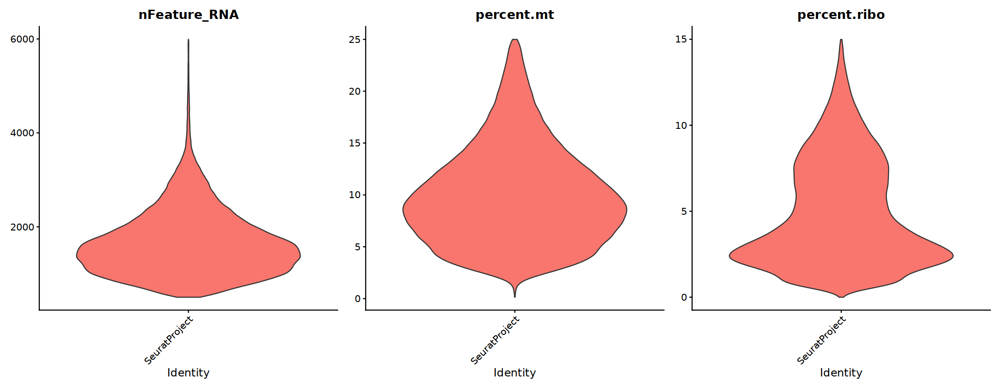

In [86]:
mer@active.assay="RNA"
mer$percent.mt=PercentageFeatureSet(mer,pattern = "^MT-",assay = "RNA")
mer$percent.ribo=PercentageFeatureSet(mer,pattern = "^RPS|^RPL",assay = "RNA")
mer=subset(mer,subset=nFeature_RNA>500  & nFeature_RNA<6000 & percent.mt < 25 & percent.ribo < 15 & scDblFinder.class=="singlet")

VlnPlot(mer,c("nFeature_RNA","percent.mt","percent.ribo"),pt.size = 0,group.by = "orig.ident")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



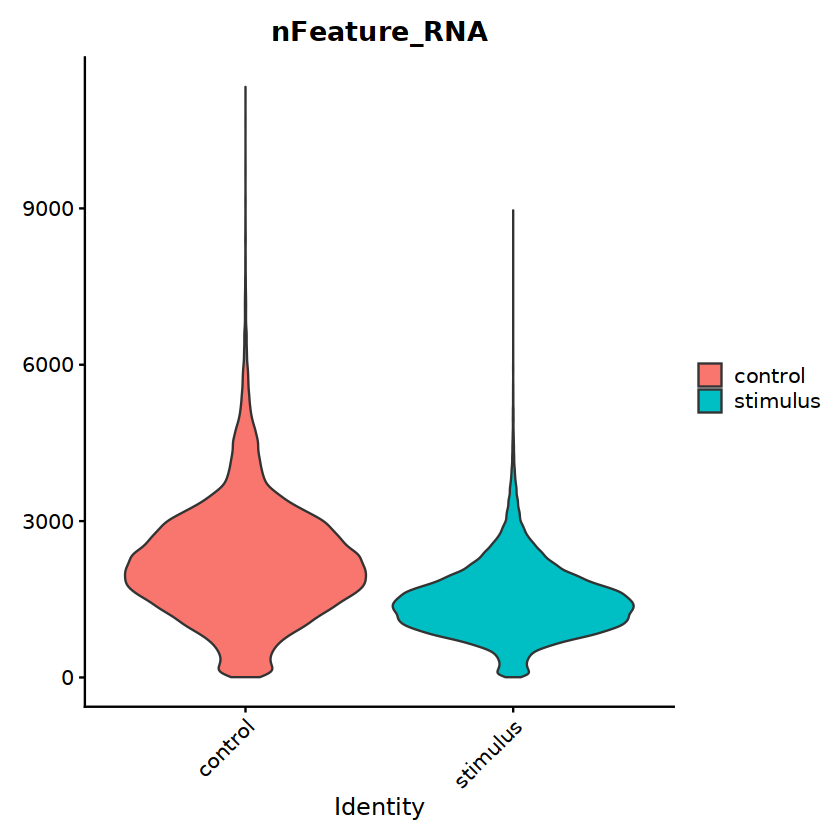

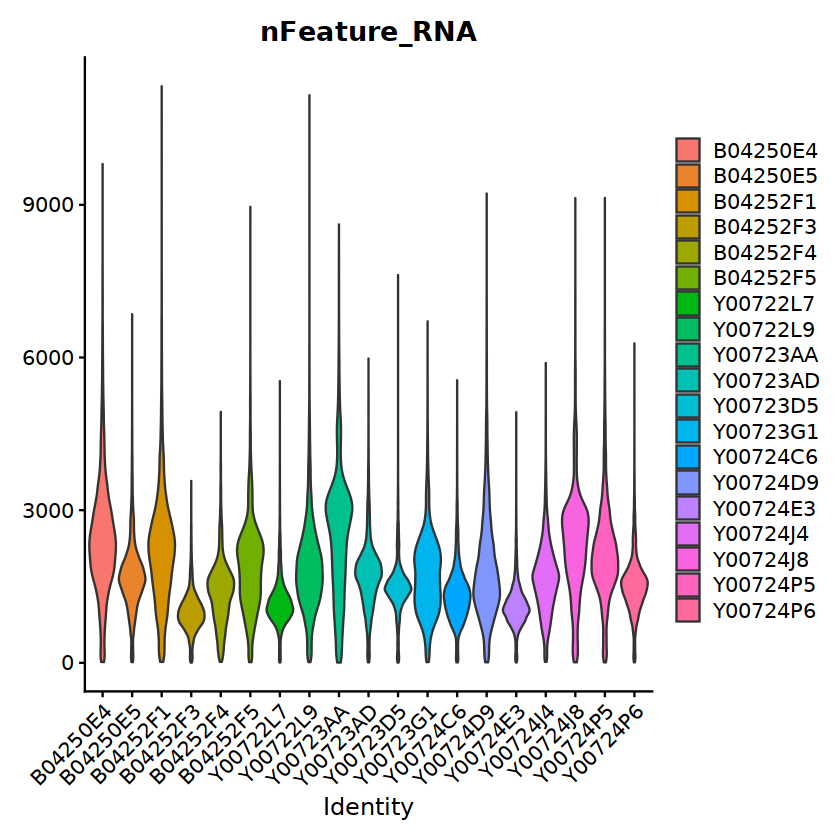

In [41]:
VlnPlot(mer,"nFeature_RNA",group.by="conditions",pt.size=0)
VlnPlot(mer,"nFeature_RNA",group.by="sample",pt.size=0)

In [36]:
mer$conditions=plyr::mapvalues(mer$sample,from=c("Y00724E3",
"Y00722L7",
"B04252F3",
"Y00724C6",
"Y00724P6",
"B04250E5",
"B04252F4",
"Y00724J4",
"B04252F5",
"Y00723G1",
"Y00723AD",
"Y00723D5",
"Y00724D9",
"Y00722L9",
"B04252F1",
"Y00724P5",
"B04250E4",
"Y00723AA",
"Y00724J8"
),to=c("stimulus","stimulus","stimulus","stimulus","stimulus","stimulus","stimulus","stimulus","stimulus","stimulus","stimulus","stimulus","control","control","control","control","control","control","control"))

In [56]:
mer@active.assay="Protein"
mer=NormalizeData(mer,verbose = F,normalization.method = 'CLR', margin = 2)
VariableFeatures(mer) <- rownames(obj[["Protein"]])
mer=ScaleData(mer,verbose=F)
mer=RunPCA(mer,reduction.name = "apca")

mer=RunHarmony(mer,group.by.vars = "sample",reduction.use = "apca")
mer=RunUMAP(mer,reduction = "harmony",dims = 1:5,reduction.name = "pumap")
mer=FindNeighbors(mer,reduction="harmony",dims = 1:5)
mer=FindClusters(mer,resolution=0.3)

PC_ 1 
Positive:  CD13-Hu, CD62P-Hu, CD192-Hu, CD116-Hu, CD93-Hu, CD61-Hu, CD41-Hu, CD14-Hu-M5E2, HLA-DR-Hu, CD33-Hu 
	   CD49b-Hu, CD39-Hu, CD354-Hu, CD141-Hu, CD371-Hu, CD36-Hu, CD172a-Hu, CD64-Hu, CD58-Hu, CD35-Hu 
	   CD74-Hu, HLA-DR-DP-DQ-Hu, CD32-Hu, HLA-A-B-C-Hu, Ig-light-chain-k-Hu, CD86-Hu, CD9-Hu, CD163-Hu, CD42b-Hu, LOX1-Hu 
Negative:  CD2-Hu, CD94-Hu, CD366-Ms, CD314-Ms, CD186-Hu, TCR-Va24-Ja18-Hu, TCR-vb8-3-Ms, CD8a-Ms, CD61-Ms, CD198-Hu 
	   CD90-2-Ms, CD179a-Hu, XCR1-Ms, CD120b-Ms, CD106-Ms, CD1a-Hu, XCR1-Hu, CD3-Hu-SK7, CD79b-Ms, CD202b-Hu 
	   CD41-Ms, VISTA-Ms, I-A-I-E-Ms, MERTK-Hu, CD317-Ms, CD371-Ms, Isotype-Rat-IgMk, CD284-Hu, CD95-Ms, CD278-Ms 
PC_ 2 
Positive:  CD5-Hu, CD28-Hu, CD2-Hu, CD48-Hu, CD27-Hu, CD52-Hu, CD3-Hu-UCHT1, CD45-Hu-HI30, TCR-a-b-Hu, CD99-Hu 
	   CD127-Hu, CD44-MsHu, CD26-Hu, CD278-MsHu, CD47-Hu, CD162-Hu, CD49f-Hu, CD352-Hu, CD45RO-Hu, CD55-Hu 
	   CD4-Hu-RPA-T4, CD7-Hu, CD82-Hu, CD8-Hu, CD101-Hu, Integrin-b7-MsHu, CD49d-Hu, CD81-Hu, CD73-Hu, C

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 192666
Number of edges: 5102562

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9257
Number of communities: 11
Elapsed time: 200 seconds


In [61]:
mer=RunUMAP(mer,reduction = "harmony",dims = 1:10,reduction.name = "pumap")
mer=FindNeighbors(mer,reduction="harmony",dims = 1:10)
mer=FindClusters(mer,resolution=0.3)

15:33:24 UMAP embedding parameters a = 0.9922 b = 1.112

15:33:24 Read 192666 rows and found 10 numeric columns

15:33:24 Using Annoy for neighbor search, n_neighbors = 30

15:33:24 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:33:52 Writing NN index file to temp file /tmp/RtmpD8bfgp/fileb1e19d48234

15:33:52 Searching Annoy index using 1 thread, search_k = 3000

15:35:51 Annoy recall = 100%

15:35:52 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

15:36:00 Initializing from normalized Laplacian + noise (using irlba)

15:36:25 Commencing optimization for 200 epochs, with 8169002 positive edges

15:38:52 Optimization finished

Warning message:
“Cannot add objects with duplicate keys (offending key: UMAP_) setting key to orig

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 192666
Number of edges: 4804251

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9461
Number of communities: 13
Elapsed time: 179 seconds


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



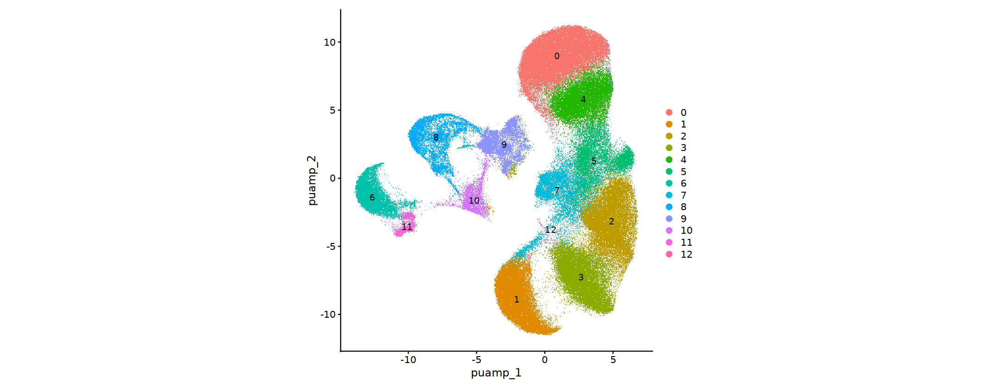

In [64]:
DimPlot(mer,reduction="puamp",label=T)+coord_fixed()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



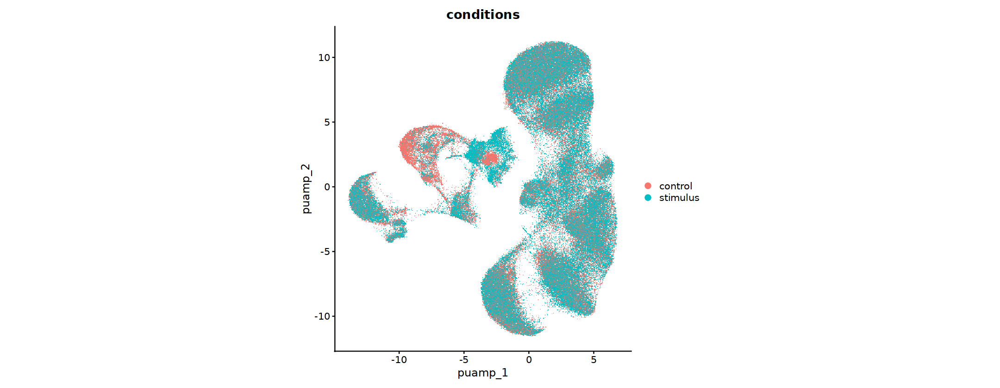

In [63]:
DimPlot(mer,reduction="puamp",group.by="conditions")+coord_fixed()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



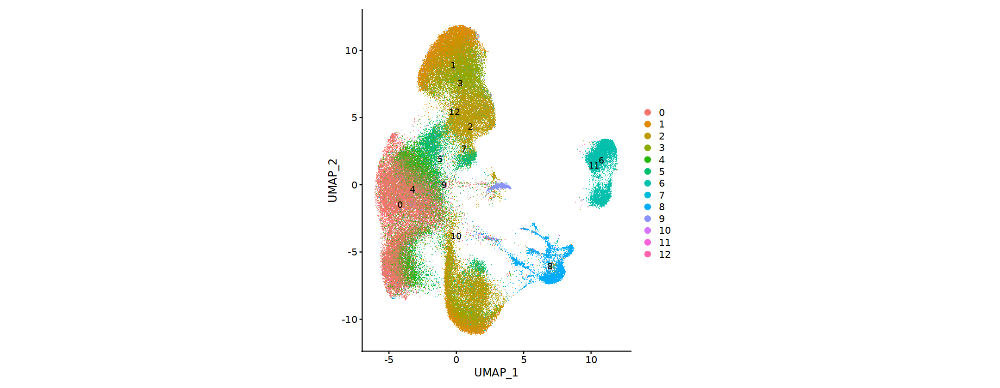

In [87]:
DimPlot(mer,reduction="umap",label=T)+coord_fixed()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



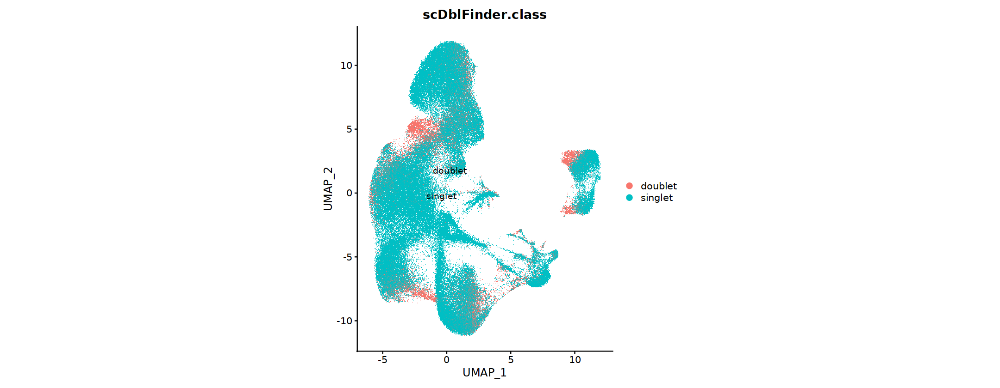

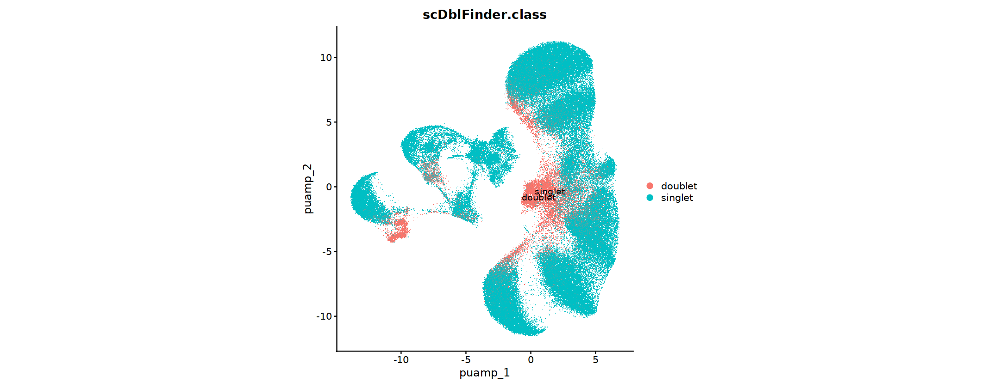

In [77]:
DimPlot(mer,reduction="umap",label=T,group.by="scDblFinder.class")+coord_fixed()
DimPlot(mer,reduction="puamp",label=T,group.by="scDblFinder.class")+coord_fixed()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



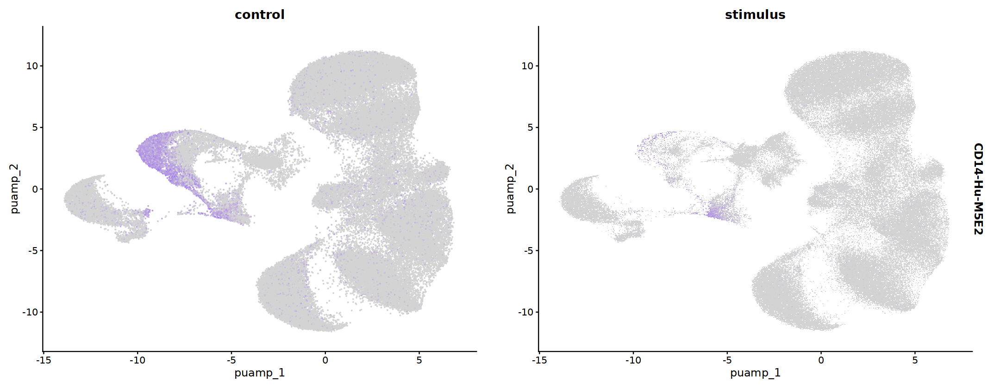

In [75]:
FeaturePlot(mer,"CD14-Hu-M5E2",reduction="puamp",split.by="conditions")#+coord_fixed()

In [36]:
gc()

,used,(Mb),gc trigger,(Mb),max used,(Mb)
Ncells,3636845,194.3,6705001,358.1,6705001,358.1
Vcells,1284373235,9799.0,3810420085,29071.2,4756772439,36291.3


In [3]:
mer=readRDS("filter.merge.rds")
features <- SelectIntegrationFeatures(object.list = SplitObject(mer,split.by="sample"))
options(future.globals.maxSize=10000000000000000000)
library(future)
plan("multicore", workers = 10)
anchors <- FindIntegrationAnchors(object.list = SplitObject(mer,split.by="sample"), anchor.features = features)
plan("multicore", workers = 1)
obj.combined <- IntegrateData(anchorset = anchors)

Scaling features for provided objects

Finding all pairwise anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 20052 anchors

Filtering anchors

	Retained 4213 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 19725 anchors

Filtering anchors

	Retained 6912 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 19987 anchors

Filtering anchors

	Retained 4156 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 20212 anchors

Filtering anchors

	Retained 4502 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 20242 anchors

Filtering anchors

	Retained 11299 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 20136 anchors

Filtering anchors

	Retained 4618 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 19134 anchors

Filtering anchors

	Retained

In [7]:
obj.combined <- ScaleData(obj.combined, verbose = FALSE)
obj.combined=RunPCA(obj.combined)
obj.combined=RunUMAP(obj.combined,dims = 1:15)
obj.combined=FindNeighbors(obj.combined,dims = 1:15)
obj.combined=FindClusters(obj.combined)

PC_ 1 
Positive:  BACH2, CAMK2D, PAM, CRTAM, IL7R, NR4A3, CAMK4, AC093677.3, ELMO1, XCL1 
	   XCL2, IL2, INPP4B, PKIA, MIR31HG, IFNG, CD40LG, TSHZ2, ANK3, CD200 
	   IKZF2, GRIP1, LEF1, TBC1D4, TGFBR3, JARID2, BIRC3, TNFSF8, PDE4D, CAMK1D 
Negative:  CXCL2, CTSL, ST3GAL6, AQP9, INHBA, AC025580.2, ELOVL7, KYNU, BAALC, LINC01181 
	   CCRL2, EREG, LINC01010, PLAUR, DCSTAMP, IL1B, MMP19, ZC3H12C, MCTP1, IRAK2 
	   CXCL8, AC005280.3, CXCL3, FNIP2, TNFSF15, PTGS2, KMO, TM4SF19-TCTEX1D2, MTCO1P4, G0S2 
PC_ 2 
Positive:  EBF1, KCNQ5, HDAC9, UBE2E2, HLA-DQA1, MACC1, AP1S3, CMSS1, CCR7, POU2AF1 
	   ST6GALNAC3, BCAR3, MIR155HG, PLEKHG1, CDK14, BASP1, NETO1, AL121768.1, LINC00158, PIKFYVE 
	   UGT8, KHDRBS3, RASGRP3, AP001341.1, PHACTR1, TXNRD1, TFEC, ABTB2, TNS3, CCSER1 
Negative:  CRTAM, ZEB2, NR4A3, TMEM117, XCL2, PLCB1, NCAM1, XCL1, TGFBR3, ATP8B4 
	   BNC2, THBS1, C1orf21, CADM1, PAM, MT-TL1, ARHGAP15, IKZF2, FNDC3B, PLEK 
	   ITGAX, FAM129A, IFNG, NUMB, AC009093.8, AUTS2, PRDM1, DPYD, NCALD

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 157479
Number of edges: 5102209

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9031
Number of communities: 30
Elapsed time: 156 seconds


1 singletons identified. 29 final clusters.



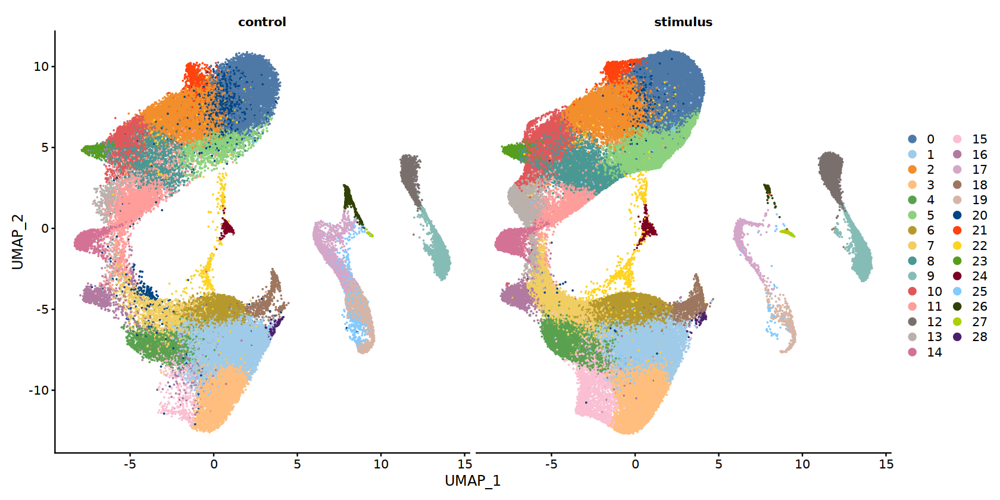

In [22]:
options(repr.plot.width=14)
DimPlot(obj.combined,split.by="conditions",raster=F)+scale_color_manual(values=c(ggthemes::tableau_color_pal("Tableau 20")(20),ggthemes::calc_pal()(10)))

In [3]:
obj=readRDS("filter.merge.rds")
obj=subset(obj,subset=conditions=="control")
meta=read.csv("CITE-seq-metadata.csv",header=T,row.names=1)
obj$annotation=meta[rownames(obj@meta.data),"seurat_annotations"]

In [4]:
obj=subset(obj,cells=Cells(obj)[!is.na(obj$annotation)])
obj

An object of class Seurat 
52471 features across 54761 samples within 2 assays 
Active assay: RNA (52064 features, 2000 variable features)
 1 other assay present: Protein
 5 dimensional reductions calculated: pca, harmony, umap, apca, puamp

In [4]:
library(harmony)

Loading required package: Rcpp



In [10]:
obj=readRDS("control.wnn3.rds")

In [6]:
obj@active.assay="RNA"
features <- SelectIntegrationFeatures(object.list = SplitObject(obj,split.by="sample"))
options(future.globals.maxSize=10000000000000000000)
library(future)
plan("multicore", workers = 20)
anchors <- FindIntegrationAnchors(object.list = SplitObject(obj,split.by="sample"), anchor.features = features)
plan("multicore", workers = 1)
obj.combined <- IntegrateData(anchorset = anchors)

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from rna.pca_ to rnapca_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from rna.umap_ to rnaumap_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from protein.pca_ to proteinpca_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from protein.umap_ to proteinumap_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from rna.pca_ to rnapca_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from rna.umap_ to rnaumap_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from protein.pca_ to proteinpca_”
Warning message:
“Keys should be

In [ ]:
obj.combined <- ScaleData(obj.combined, verbose = FALSE)
obj.combined=RunPCA(obj.combined)
obj.combined=RunUMAP(obj.combined,dims = 1:15)
obj.combined=FindNeighbors(obj.combined,dims = 1:15)
obj.combined=FindClusters(obj.combined)

PC_ 1 
Positive:  CAMK4, LEF1, PDE4D, SMYD3, LINC01934, ANK3, BACH2, EPHX1, NR3C2, NELL2 
	   NLGN1, PKIA, TGFBR3, ZEB1, SLC16A10, SATB1-AS1, ICOS, KLRC4-KLRK1, EPHA4, C1orf21 
	   WWOX, AP001977.1, PCED1B, ZBTB20, CSGALNACT1, RASGRF2, LRRN3, TSHZ2, PLCL1, LEF1-AS1 
Negative:  RBM47, KYNU, SLC7A11, IL1B, WDFY3, CXCL8, PLXDC2, DOCK4, NAMPT, NEAT1 
	   IRAK3, CD83, SPI1, ACSL1, DENND5A, TNFAIP2, IRAK2, TLR2, NLRP3, CD86 
	   NCF2, RAB31, HCK, ZC3H12C, LYN, ATF3, PID1, PLAUR, AC025580.2, MAP3K8 
PC_ 2 
Positive:  C1orf21, EPHX1, PLCB1, TGFBR3, AOAH, GPR141, KLRC4-KLRK1, SLCO3A1, ZEB2, GNG2 
	   NLGN1, NCALD, PLEK, DOCK5, ARHGAP26, BNC2, PPP2R2B, CADM1, ANXA1, PDGFD 
	   SGCD, EPDR1, MALAT1, JAKMIP2, DTHD1, AC005747.1, NCAM1, COLGALT2, PIK3R5, PRDM1 
Negative:  BANK1, EBF1, AFF3, RUBCNL, COBLL1, PLEKHG1, PYY, MS4A1, TCF4, PALM2-AKAP2 
	   ADAM28, COL19A1, BLNK, CCSER1, MEF2C, KHDRBS2, ACSM3, AP001993.1, WDFY4, ARHGAP24 
	   DENND5B, CD74, C12orf42, RALGPS2, FAM111B, OSBPL10, PAWR, SAMD4A, 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 54761
Number of edges: 1906777

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8920
Number of communities: 22
Elapsed time: 27 seconds


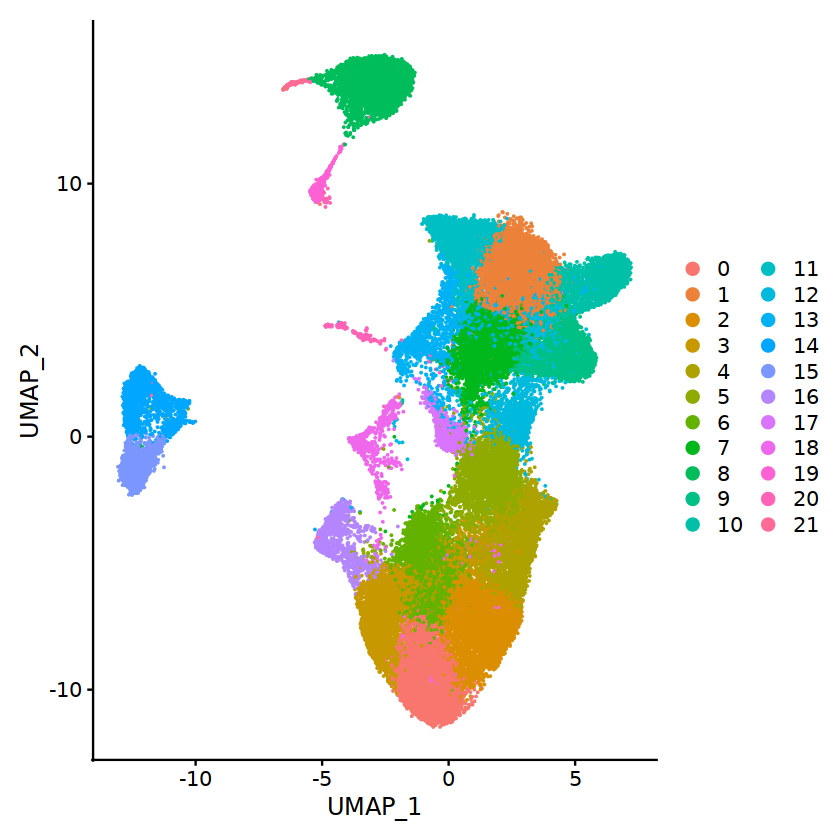

In [8]:
DimPlot(obj.combined)+coord_fixed()

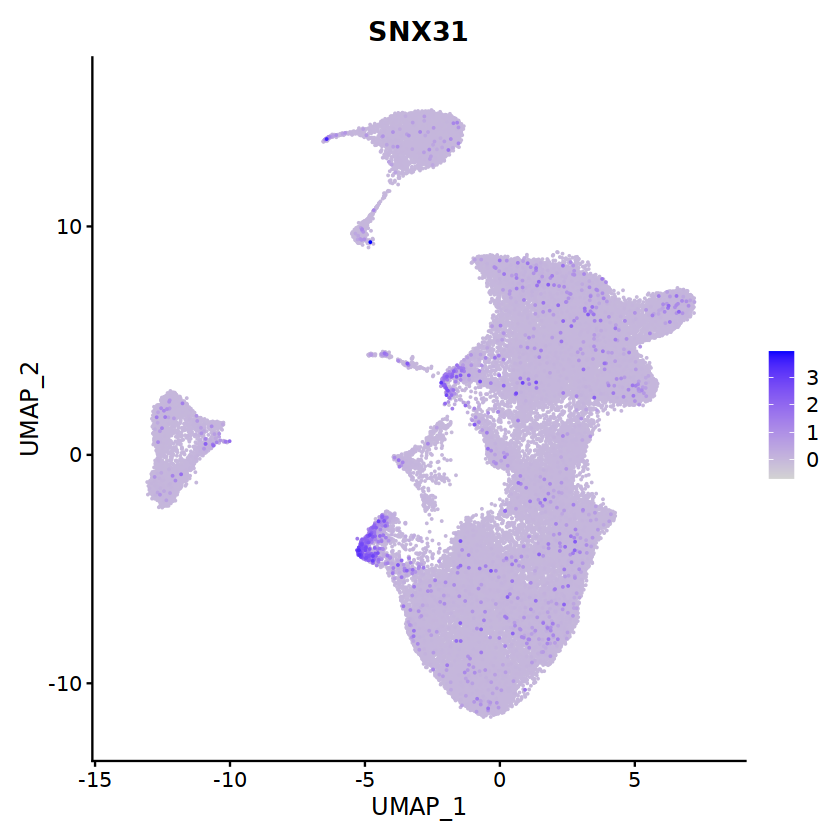

In [9]:
FeaturePlot(obj.combined,"SNX31",order=T)

In [5]:
obj@active.assay="RNA"
obj=NormalizeData(obj,verbose = F)
obj=FindVariableFeatures(obj,verbose=F,nfeatures = 3000)
obj=ScaleData(obj,verbose=F)
obj=RunPCA(obj,reduction.name="rna.pca")
obj=RunHarmony(obj,group.by.vars="sample",reduction.use="rna.pca",reduction.save="rna.harmony")
obj=RunUMAP(obj,reduction = "rna.harmony",dims = 1:22,reduction.name="rna.umap",min.dist=0.2)
obj=FindNeighbors(obj,reduction="rna.harmony",dims = 1:20)
obj=FindClusters(obj)
obj$seurat_cluster_rna=obj$seurat_clusters

PC_ 1 
Positive:  PRKCH, CAMK4, TNIK, SKAP1, LEF1, SMYD3, PDE4D, LINC01934, ANK3, ZEB1 
	   BACH2, NELL2, ZBTB20, SATB1-AS1, SLC16A10, TGFBR3, PKIA, NR3C2, KLRC4-KLRK1, PLCL1 
	   ICOS, AP001977.1, WWOX, C1orf21, SAMD3, PCED1B, CSGALNACT1, EPHX1, PLCXD2, TSHZ2 
Negative:  RBM47, KYNU, SLC7A11, IL1B, CXCL8, DOCK4, PLXDC2, NEAT1, NAMPT, WDFY3 
	   DENND5A, CD83, IRAK3, SPI1, ACSL1, TNFAIP2, IRAK2, NLRP3, LYN, HCK 
	   NCF2, RAB31, PLAUR, TLR2, AC025580.2, EVI5, PID1, MAP3K8, LRMDA, CD86 
PC_ 2 
Positive:  EBF1, AFF3, BANK1, PLEKHG1, RUBCNL, COBLL1, TCF4, MS4A1, BLNK, PALM2-AKAP2 
	   CCSER1, ADAM28, ZEB1, RALGPS2, PYY, BACH2, WDFY4, COL19A1, MEF2C, ARHGAP24 
	   C12orf42, KHDRBS2, PAWR, ACSM3, DENND5B, RHOH, AP001993.1, STAP1, PAX5, PTK2 
Negative:  C1orf21, ZEB2, TGFBR3, PLCB1, GPR141, EPHX1, SAMD3, AOAH, KLRC4-KLRK1, NCALD 
	   GNG2, PPP2R2B, MCTP2, PDGFD, FAM129A, BNC2, SGCD, CADM1, DOCK5, ATXN1 
	   DTHD1, PLEK, VAV3, ARHGAP26, AUTS2, EPDR1, JAKMIP2, PLCXD2, COLGALT2, AC005747.1 
PC_

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 54761
Number of edges: 1631617

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8724
Number of communities: 20
Elapsed time: 26 seconds


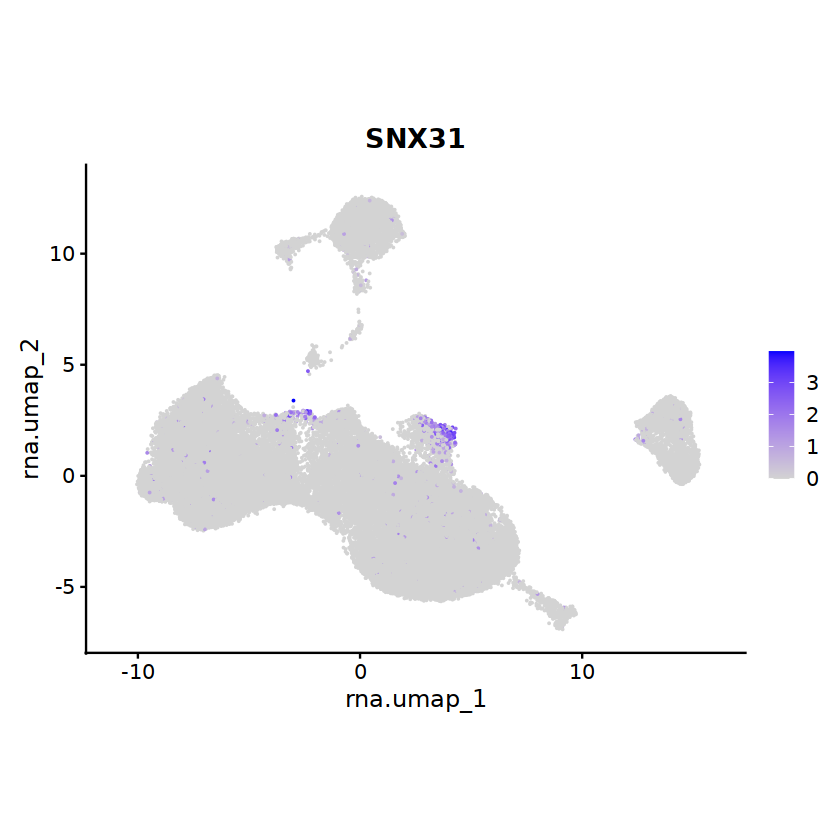

In [6]:
FeaturePlot(obj,"SNX31",reduction="rna.umap")+coord_fixed()

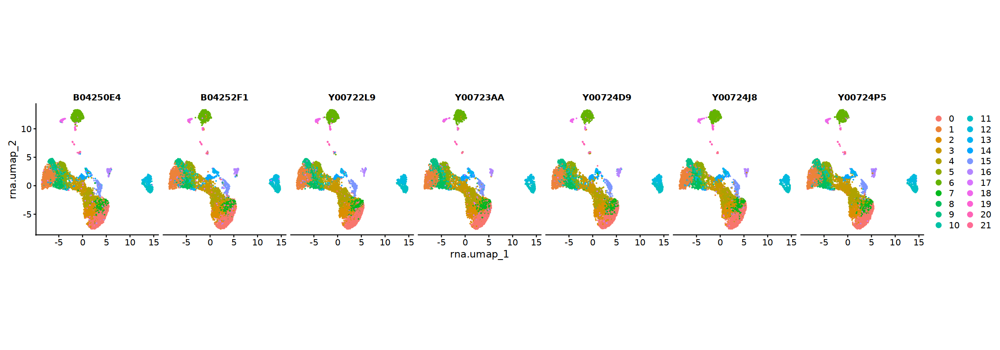

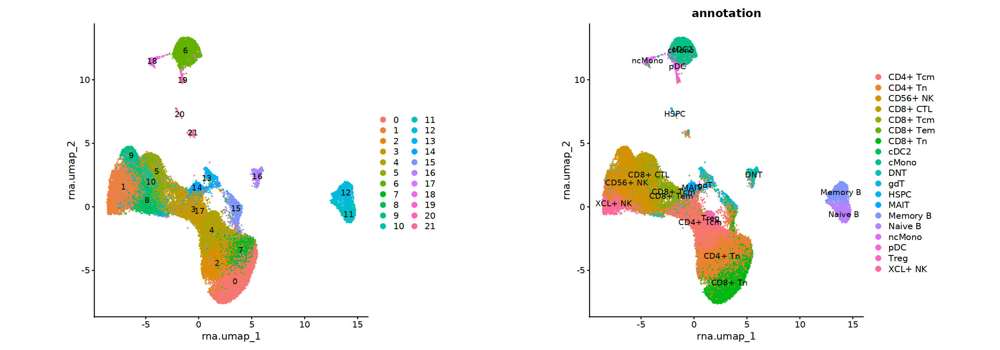

In [43]:
options(repr.plot.width=20) # dims 1:25
DimPlot(obj,split.by="sample",reduction="rna.umap")+coord_fixed(ratio=1.2)
DimPlot(obj,reduction="rna.umap",label=T)+coord_fixed(ratio=1.2)|DimPlot(obj,reduction="rna.umap",label=T,group.by="annotation")+coord_fixed(ratio=1.2)

In [40]:
marker8=FindMarkers(ds,group.by="seurat_clusters",ident.1=8)

In [37]:
markers=FindMarkers(ds,group.by="seurat_clusters",ident.1=14)

In [36]:
ds=subset(obj,downsample=500)

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from rna.pca_ to rnapca_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from rna.umap_ to rnaumap_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from protein.pca_ to proteinpca_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from protein.umap_ to proteinumap_”


In [122]:
#test=obj@assays$Protein[df$PIDName1[df$PIDName1 %in% rownames(obj@assays$Protein@counts)]]
#obj[["Protein"]]=CreateAssayObject(test)

In [9]:
obj@active.assay="Protein"
obj=NormalizeData(obj,verbose = F)
VariableFeatures(obj)=rownames(obj@assays$Protein@counts)
obj=ScaleData(obj,verbose=F)
obj=RunPCA(obj,reduction.name="protein.pca")
obj=RunHarmony(obj,group.by.vars = "sample",reduction.use="protein.pca",reduction.save="protein.harmony")
obj=RunUMAP(obj,reduction = "protein.harmony",reduction.name="protein.umap",dims = 1:15,min.dist=0.2)
obj=FindNeighbors(obj,reduction="protein.harmony",dims = 1:15)
obj=FindClusters(obj)
obj$seurat_cluster_protein=obj$seurat_clusters

PC_ 1 
Positive:  CD14-Hu-M5E2, CD93-Hu, CD64-Hu, CD116-Hu, CD32-Hu, CD86-Hu, CD354-Hu, CD13-Hu, CD155-Hu, CD35-Hu 
	   CD371-Hu, CD40-Hu, CLEC1B-Hu, CD88-Hu, CD141-Hu, CD33-Hu, CD42b-Hu, CD85j-Hu, CD11b-Hu, CD109-Hu 
	   CD36-Hu, CD49b-Hu, CD192-Hu, CD39-Hu, CD172a-Hu, CD63-Hu, CD163-Hu, CD11c-Hu, CD107a-Hu, CD123-Hu 
Negative:  CD48-Hu, CD99-Hu, CD45-Hu-HI30, CD2-Hu, CD352-Hu, CD81-Hu, CD45RA-Hu, CD162-Hu, TCR-a-b-Hu, CD28-Hu 
	   CD3-Hu-UCHT1, CD27-Hu, CD7-Hu, CD278-MsHu, CD127-Hu, CD52-Hu, CD11a-Hu, CD5-Hu, CD26-Hu, HLA-A-B-C-Hu 
	   CD62L-Hu, CD8-Hu, CD47-Hu, CD43-Hu, Integrin-b7-MsHu, CD314-Hu, CD4-Hu-RPA-T4, CD44-MsHu, CD305-Hu, CD73-Hu 
PC_ 2 
Positive:  GPR56-Hu, NKp80-Hu, CD56-Hu-5-1H11, CD94-Hu, CD244-Hu, CX3CR1-Hu, CD16-Hu, CD57-Hu, CD328-Hu, CD43-Hu 
	   KLRG1-Hu, CD151-Hu, CD161-Hu, CD335-Hu, TIGIT-Hu, CD11c-Hu, CD226-Hu-11A8, CD11a-Hu, CD63-Hu, CD319-Hu 
	   CD11b-Hu, CD58-Hu, CD45RA-Hu, Ig-light-chain-k-Hu, CD18-Hu, CD95-Hu, CD122-Hu, CD81-Hu, CD162-Hu, CD314-Hu 
Negati

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 54761
Number of edges: 1326434

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8659
Number of communities: 12
Elapsed time: 21 seconds


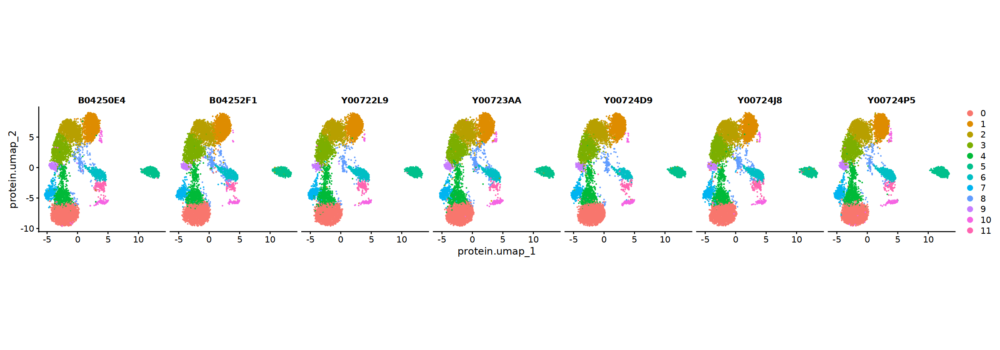

In [10]:
options(repr.plot.width=20) # dims 1:20
DimPlot(obj,split.by="sample",reduction="protein.umap")+coord_fixed()

In [ ]:
saveRDS(obj,"control.wnn3.rds")

Warning message:
“Could not find LOX1-Hu in the default search locations, found in Protein assay instead”
Warning message:
“Could not find LOX1-Hu in the default search locations, found in Protein assay instead”
Warning message:
“Could not find LOX1-Hu in the default search locations, found in Protein assay instead”


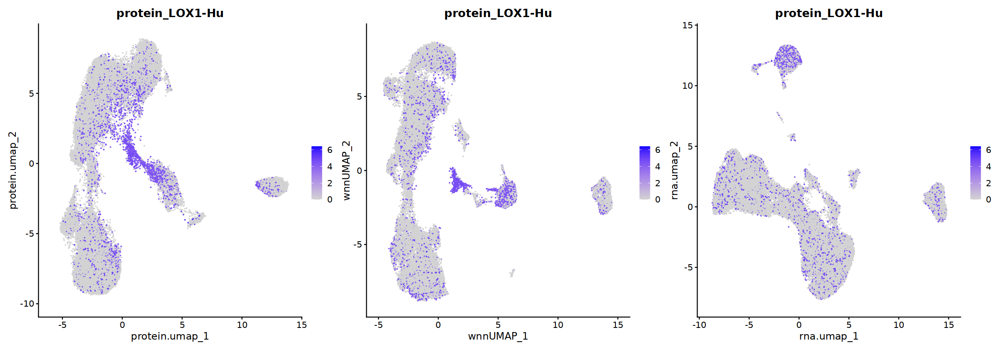

In [53]:
FeaturePlot(obj,reduction="protein.umap",features="LOX1-Hu")|FeaturePlot(obj,reduction="wnn.umap",features="LOX1-Hu")|FeaturePlot(obj,reduction="rna.umap",features="LOX1-Hu")

Warning message:
“Could not find CD16-Hu in the default search locations, found in Protein assay instead”
Warning message:
“Could not find LOX1-Hu in the default search locations, found in Protein assay instead”
Warning message:
“Could not find LOX1-Hu in the default search locations, found in Protein assay instead”


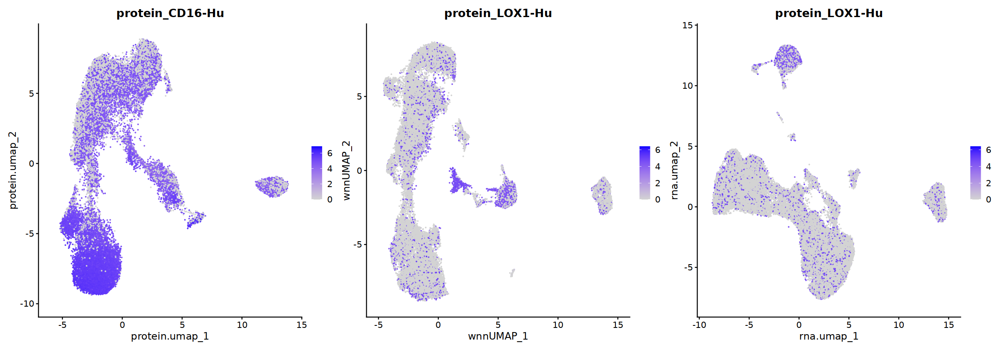

In [42]:
FeaturePlot(obj,reduction="protein.umap",features="CD16-Hu")|FeaturePlot(obj,reduction="wnn.umap",features="LOX1-Hu")|FeaturePlot(obj,reduction="rna.umap",features="LOX1-Hu")

In [134]:
sub=subset(obj,downsample=200)

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from rna.pca_ to rnapca_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from rna.umap_ to rnaumap_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from protein.pca_ to proteinpca_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from protein.umap_ to proteinumap_”


In [143]:
sub@active.assay="Protein"
markers1=FindAllMarkers(sub)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 21



In [157]:
sub@active.assay="RNA"
markers=FindAllMarkers(sub)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 21



In [ ]:
saveRDS(markers,"sub.wnn.cluster.rna.rds")
saveRDS(markers1,"sub.wnn.cluster.protein.rds")

In [147]:
saveRDS(obj,"control.wnn2.rds")

In [3]:
obj=readRDS("control.wnn2.rds")

In [11]:
obj@active.assay="RNA"
obj <- FindMultiModalNeighbors(
  obj, reduction.list = list("rna.harmony", "protein.harmony"), 
  dims.list = list(1:20, 1:15), modality.weight.name = c("RNA.weight","Protein.weight")
)
obj <- RunUMAP(obj, nn.name = "weighted.nn", reduction.name = "wnn.umap", reduction.key = "wnnUMAP_",min.dist=0.15)
obj <- FindClusters(obj, graph.name = "wsnn", algorithm = 3, resolution = 0.8, verbose = FALSE)

Calculating cell-specific modality weights

Finding 20 nearest neighbors for each modality.

Calculating kernel bandwidths

Finding multimodal neighbors

Constructing multimodal KNN graph

Constructing multimodal SNN graph

19:53:27 UMAP embedding parameters a = 0.9922 b = 1.112

19:53:28 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 20

19:53:30 Initializing from normalized Laplacian + noise (using irlba)

19:53:31 Commencing optimization for 200 epochs, with 1804174 positive edges

19:54:03 Optimization finished



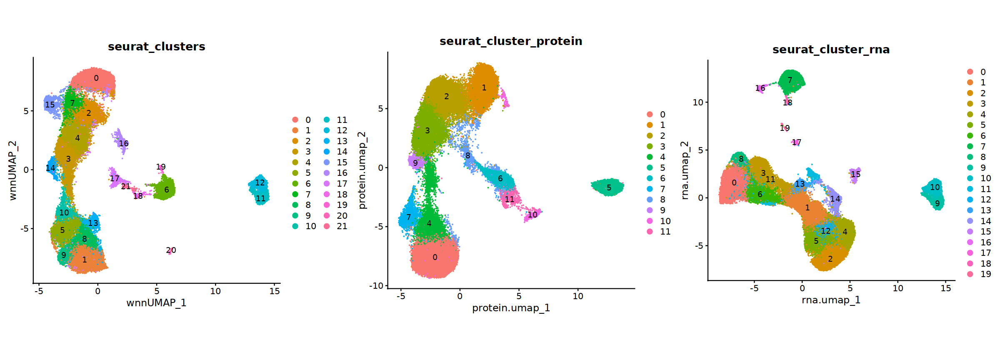

In [12]:
options(repr.plot.width=20)
DimPlot(obj,reduction="wnn.umap",group.by="seurat_clusters",label=T)+coord_fixed()|
DimPlot(obj,reduction="protein.umap",group.by="seurat_cluster_protein",label=T)+coord_fixed()|
DimPlot(obj,reduction="rna.umap",group.by="seurat_cluster_rna",label=T)+coord_fixed()

Warning message:
“Could not find LOX1-Hu in the default search locations, found in Protein assay instead”
Warning message:
“Could not find LOX1-Hu in the default search locations, found in Protein assay instead”
Warning message:
“Could not find LOX1-Hu in the default search locations, found in Protein assay instead”


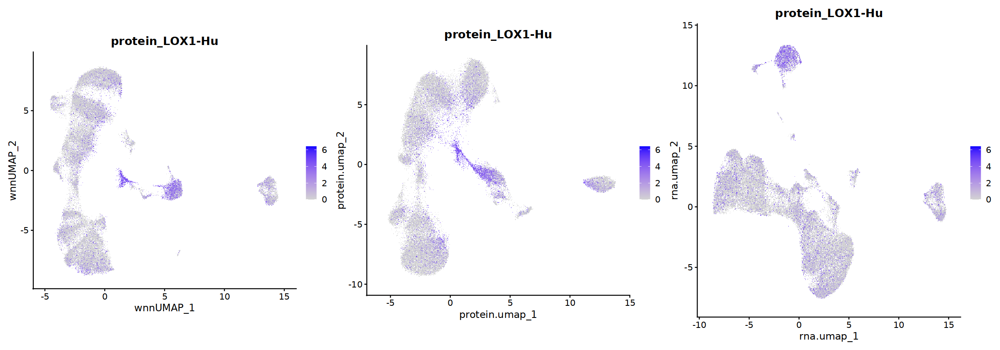

In [21]:
FeaturePlot(obj,reduction="wnn.umap",features="LOX1-Hu",raster=T)+coord_fixed()|
FeaturePlot(obj,reduction="protein.umap",features="LOX1-Hu",raster=T)+coord_fixed()|
FeaturePlot(obj,reduction="rna.umap",features="LOX1-Hu",raster=T)

In [15]:
mer=readRDS("wnn.rds")

In [18]:
mer=RunUMAP(mer,reduction = "protein_harmony",dims = 1:20,reduction.name="protein.umap")

09:26:53 UMAP embedding parameters a = 0.9922 b = 1.112

09:26:53 Read 157479 rows and found 20 numeric columns

09:26:53 Using Annoy for neighbor search, n_neighbors = 30

09:26:53 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

09:27:11 Writing NN index file to temp file /tmp/RtmpTTtzZd/file85295c5098

09:27:12 Searching Annoy index using 1 thread, search_k = 3000

09:28:27 Annoy recall = 100%

09:28:28 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

09:28:34 Initializing from normalized Laplacian + noise (using irlba)

09:28:43 Commencing optimization for 200 epochs, with 7083912 positive edges

09:30:24 Optimization finished

Warning message:
“Cannot add objects with duplicate keys (offending key: UMAP_), setting key to 'pro

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



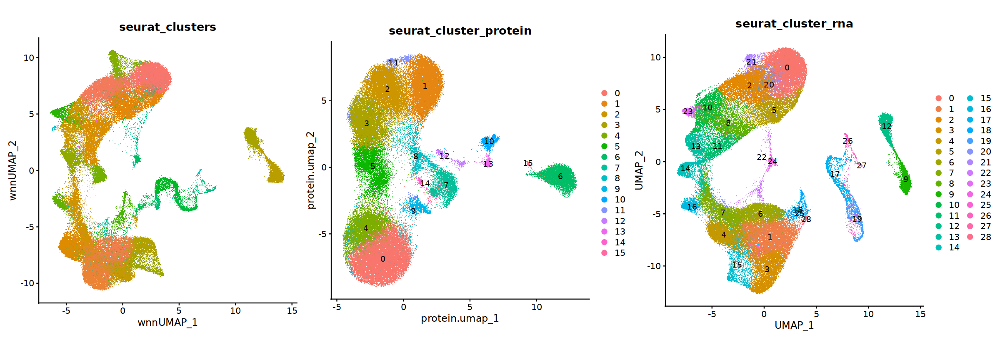

In [25]:
options(repr.plot.width=20)
DimPlot(mer,reduction="wnn.umap",group.by="seurat_clusters")+NoLegend()+coord_fixed()|
DimPlot(mer,reduction="protein.umap",group.by="seurat_cluster_protein",label=T)+coord_fixed()|
DimPlot(mer,reduction="umap",group.by="seurat_cluster_rna",label=T)+coord_fixed()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



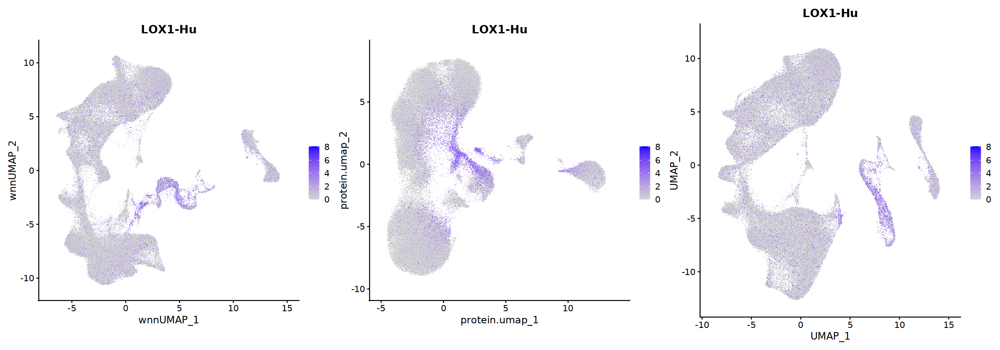

In [20]:
FeaturePlot(mer,reduction="wnn.umap",features="LOX1-Hu")+coord_fixed()|
FeaturePlot(mer,reduction="protein.umap",features="LOX1-Hu")+coord_fixed()|
FeaturePlot(mer,reduction="umap",features="LOX1-Hu")

In [31]:
library(harmony)
#obj=RunHarmony(obj,group.by.vars="sample",reduction.use="rna.pca",reduction.save="rna.harmony")
obj=RunUMAP(obj,reduction = "rna.harmony",dims = 1:22,reduction.name="rna.umap",min.dist=0.2)

20:16:39 UMAP embedding parameters a = 1.262 b = 1.003

20:16:39 Read 54761 rows and found 22 numeric columns

20:16:39 Using Annoy for neighbor search, n_neighbors = 30

20:16:39 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

20:16:47 Writing NN index file to temp file /tmp/RtmpcFzHvf/file8531f94a6b

20:16:47 Searching Annoy index using 1 thread, search_k = 3000

20:17:13 Annoy recall = 100%

20:17:14 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

20:17:16 Initializing from normalized Laplacian + noise (using irlba)

20:17:20 Commencing optimization for 200 epochs, with 2501526 positive edges

20:17:50 Optimization finished

Warning message:
“Cannot add objects with duplicate keys (offending key: UMAP_) setting key to origina

In [32]:
library(harmony)
obj=RunUMAP(obj,reduction = "protein.harmony",dims = 1:15,reduction.name="protein.umap",min.dist=0.2)

20:17:50 UMAP embedding parameters a = 1.262 b = 1.003

20:17:50 Read 54761 rows and found 15 numeric columns

20:17:50 Using Annoy for neighbor search, n_neighbors = 30

20:17:50 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

20:17:57 Writing NN index file to temp file /tmp/RtmpcFzHvf/file85338d4b8

20:17:57 Searching Annoy index using 1 thread, search_k = 3000

20:18:24 Annoy recall = 100%

20:18:25 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

20:18:28 Initializing from normalized Laplacian + noise (using irlba)

20:18:30 Commencing optimization for 200 epochs, with 2406226 positive edges

20:18:59 Optimization finished

Warning message:
“Cannot add objects with duplicate keys (offending key: UMAP_) setting key to original

In [13]:
library(scales)

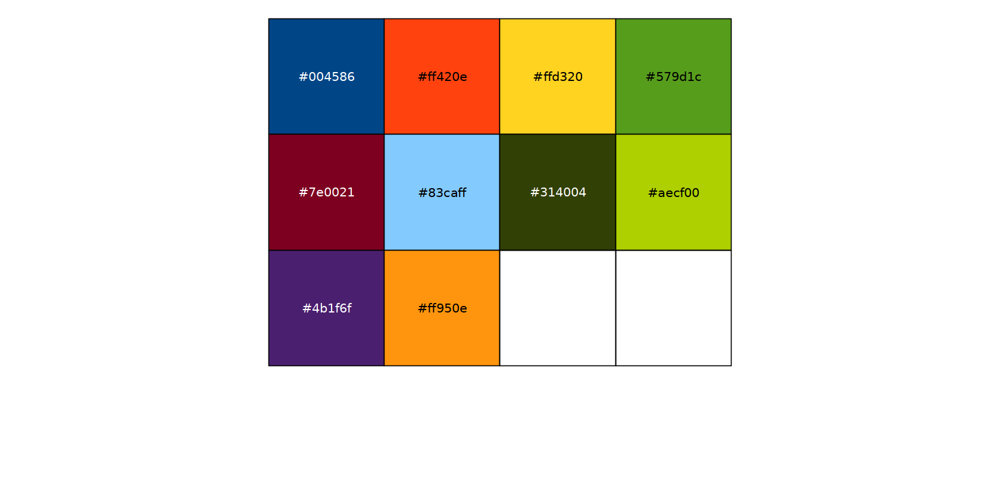

In [14]:
show_col(ggthemes::calc_pal()(10))

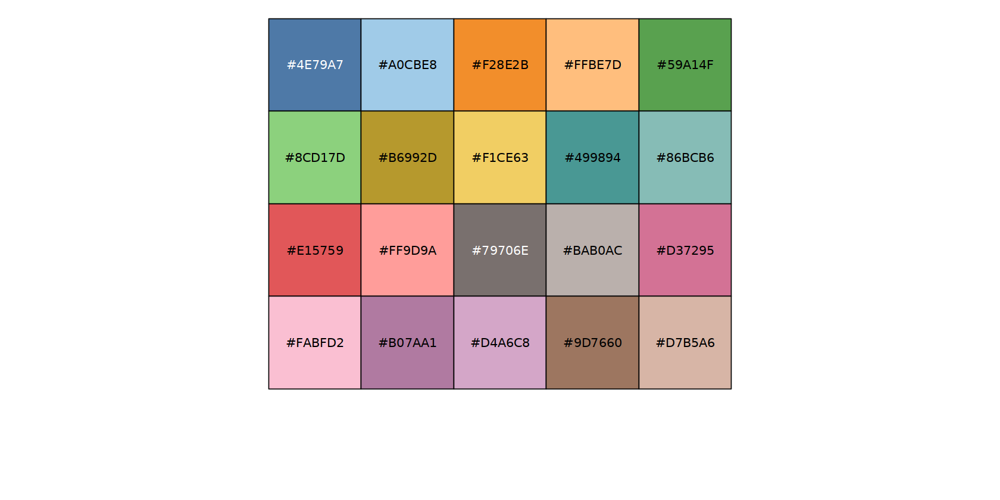

In [20]:
show_col(ggthemes::tableau_color_pal("Tableau 20")(20))

In [3]:
setwd("/data/work/Analysis")
obj.combined=readRDS("integrated.obj.rds")

In [12]:
saveRDS(obj.combined,"integrated.obj.rds")

In [64]:
obj.combined$test_cluster=mer$seurat_clusters

Warning message:
“Could not find CD8A in the default search locations, found in RNA assay instead”
Warning message:
“Could not find CD4 in the default search locations, found in RNA assay instead”


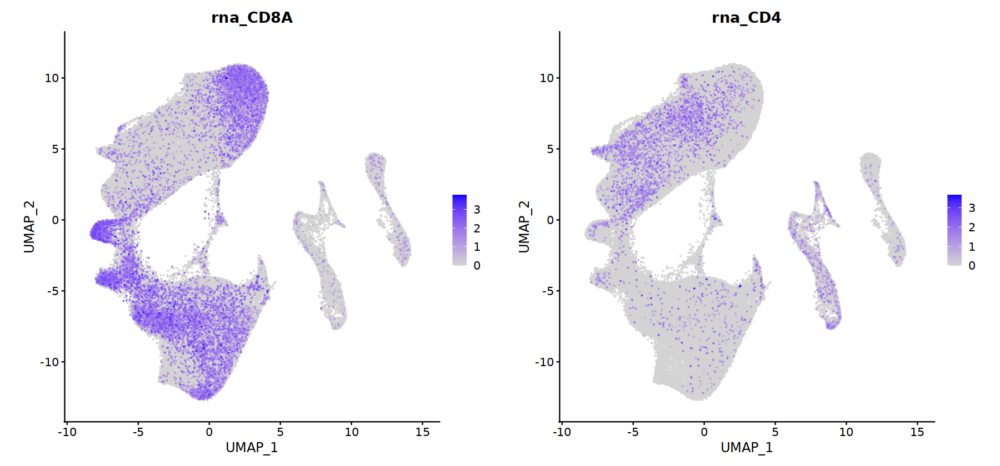

In [62]:
FeaturePlot(obj.combined,"CD8A",raster=F,order=T)+coord_fixed()|FeaturePlot(obj.combined,"CD4",raster=F,order=T)+coord_fixed()

In [70]:
marker24=FindMarkers(obj.combined,ident.1=24)

In [103]:
#marker21=FindMarkers(obj.combined,ident.1=21)
marker21_P=FindMarkers(obj.combined,ident.1=21,assay="Protein")

In [78]:
ego=enrichGO(rownames(marker24[marker24$avg_log2FC>0 & marker24$p_val_adj<0.01,]),ont="BP",keyType="SYMBOL",OrgDb="org.Hs.eg.db")

In [84]:
meta=read.csv("CITE-seq-metadata.csv",row.names=1)

In [89]:
mer$annotation=meta[rownames(mer@meta.data),"seurat_annotations"]
obj.combined$annotation=meta[rownames(obj.combined@meta.data),"seurat_annotations"]

In [92]:
obj.combined
nrow(meta)

An object of class Seurat 
54471 features across 157479 samples within 3 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 other assays present: RNA, Protein
 2 dimensional reductions calculated: pca, umap

[1] 149134

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



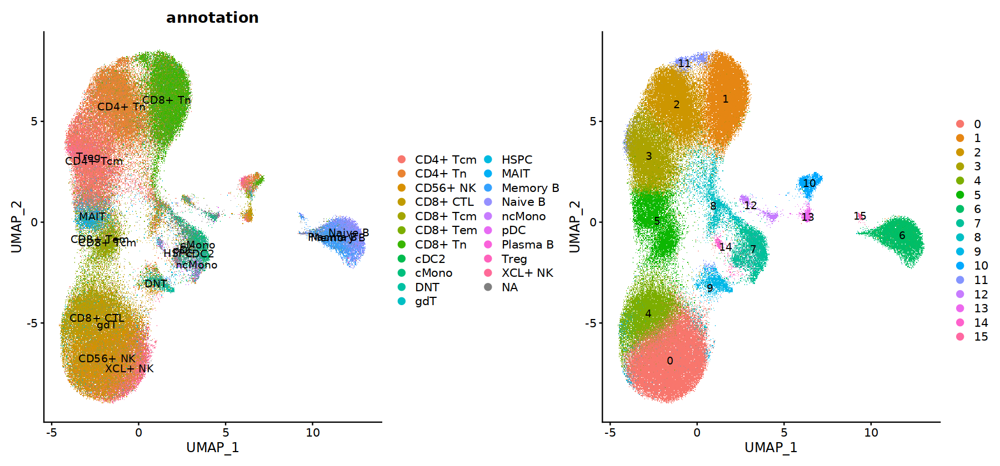

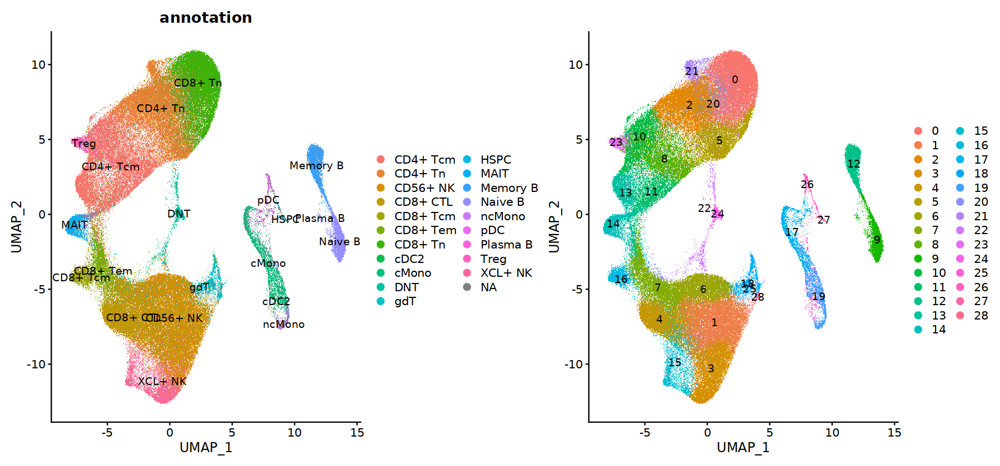

In [90]:
DimPlot(mer,group.by="annotation",label=T)|DimPlot(mer,label=T)
DimPlot(obj.combined,group.by="annotation",label=T)|DimPlot(obj.combined,label=T)

In [ ]:
mer@a

Warning message:
“Could not find CD16-Hu in the default search locations, found in Protein assay instead”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



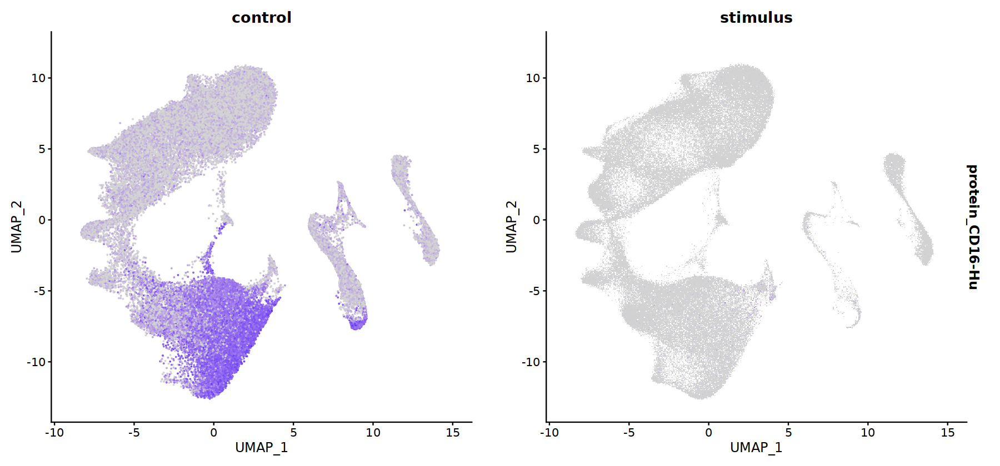

In [102]:
FeaturePlot(obj.combined,"CD16-Hu",split.by="conditions")

Warning message:
“Could not find CD56-Hu-5-1H11 in the default search locations, found in Protein assay instead”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



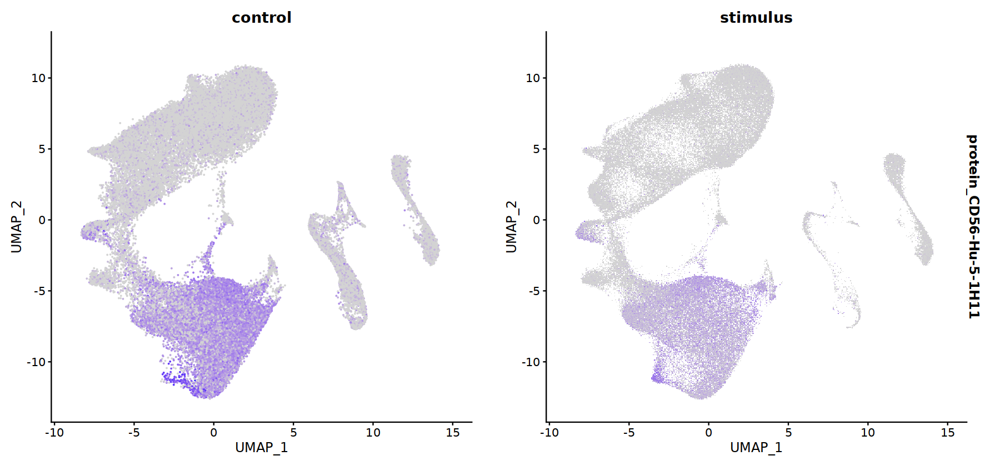

In [101]:
FeaturePlot(obj.combined,"CD56-Hu-5-1H11",split.by="conditions")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



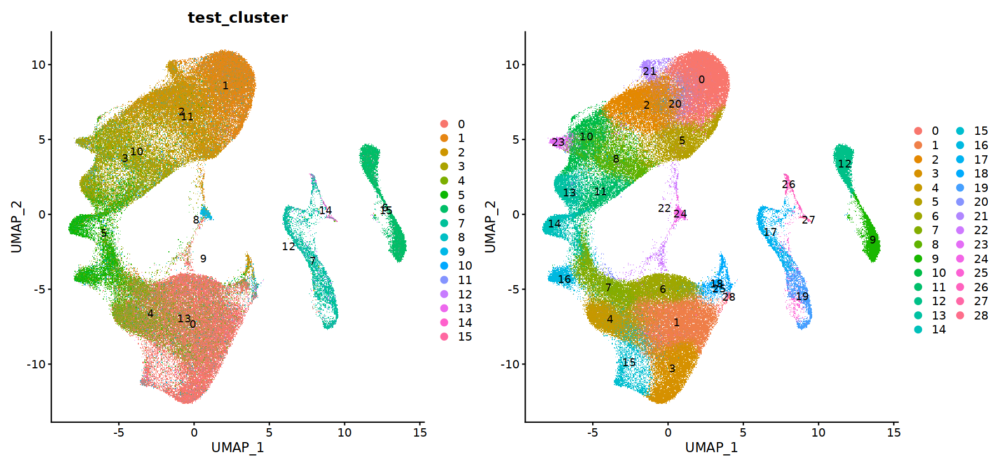

In [65]:
DimPlot(obj.combined,group.by="test_cluster",label=T)|DimPlot(obj.combined,label=T)

In [9]:
mer$RNA_cluster=obj.combined$seurat_clusters

In [31]:
test=caret::confusionMatrix(as.character(mer$seurat_clusters), as.character(mer$RNA_cluster))

ERROR: Error: `data` and `reference` should be factors with the same levels.


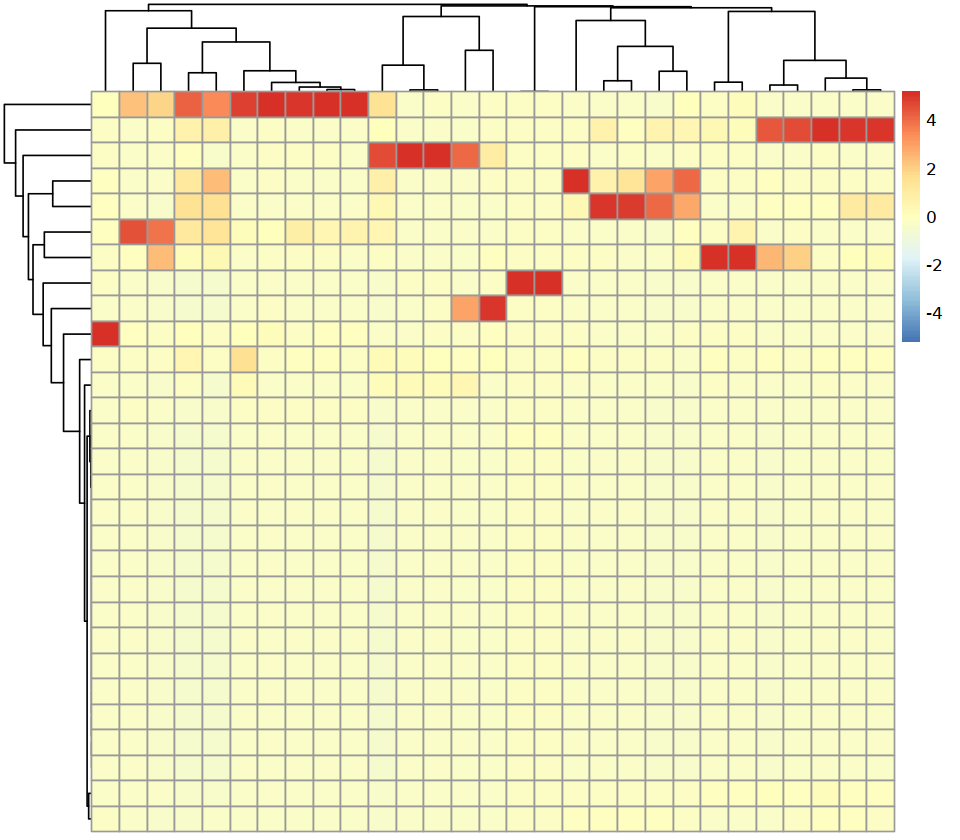

In [14]:
pheatmap::pheatmap(test,scale="column")

In [4]:
mer1=readRDS("/data/work/Analysis/protein_harmony.rds")

In [3]:
library(Seurat)
mer=readRDS("/data/work/Analysis/clean_protein_harmony.rds")

Attaching SeuratObject



In [11]:
setwd("/data/work/Analysis")
barcode=read.table("ProteinBarcodes476_V1.txt",header=T)
totalseq=read.table("Totalseq.list",sep="\t",header=T,quote="\"")
df=merge(barcode,totalseq,by.x="PIDSequence",by.y="Barcode")
df$PIDName1=gsub("_","-",df$PIDName)
rownames(df)=df$PIDName1
df1=df
#df=df[df$PIDName1 %in% rownames(mer1@assays$Protein@counts) & df$Gene.Name %in% rownames(mer1@assays$RNA@counts),]
#df=df[!duplicated(df$Gene.Name),]

In [24]:
wnn.obj=readRDS("/data/work//Final_Annotation/wnn.annotation.rds")

In [30]:
wnn.obj

An object of class Seurat 
54210 features across 149147 samples within 3 assays 
Active assay: RNA (52064 features, 0 variable features)
 2 other assays present: Protein, integrated
 6 dimensional reductions calculated: wnn.umap, protein.umap, protein.pca, protein.harmony, rna.pca, rna.umap

In [32]:
mer1=subset(mer1,cells = Cells(wnn.obj))

In [33]:
mer1@reductions[["wnn.umap"]]=wnn.obj@reductions$wnn.umap

In [49]:
color=list("cMono"=rgb(111/256,132/256,81/256),
# "cDC2"=rgb(163/256,181/256,0),
"ncMono"=rgb(118/256,141/256,128/256),
"pDC"=rgb(142/256,141/256,131/256),
"CD8+ Tn"=rgb(0,68/256,97/256),
"CD4+ Tn"=rgb(136/256,175/256,211/256),
"Treg"=rgb(55/256,98/256,167/256),
"CD4+ Tcm"=rgb(25/256,45/256,94/256),
#"CD4+ Tem"=rgb(0,110/256,142/256),
"MAIT"=rgb(50/256,164/256,195/256),
"CD8+ CTL"=rgb(158/256,213/256,205/256),
"gdT"=rgb(0,157/256,157/256),
"CD56+ NK"=rgb(148/256,90/256,123/256),
"CD16+ NK"=rgb(103/256,35/256,104/256),
"Plasma B"=rgb(238/256,121/256,67/256),
"Naive B"=rgb(248/256,240/256,129/256),
"Memory B"=rgb(226/256,41/256,18/256),
"CD8+ Tcm"=rgb(106/256,156/256,152/256),
"CD8+ Tem"=rgb(46/256,108/256,135/256),
"HSPC"=rgb(95/256,176/256,127/256),
"Activate T"="orange",
"trans T"=rgb(10/255,88/255,117/255),
"NKT"="Deep Pink",
"CAV1+ LPL+ CD8+ T"="green",
"CD112+ T cell"="gold"
          )
wnn.obj$annotation_seurat=factor(wnn.obj$annotation_seurat,levels=names(color))

png 
  2

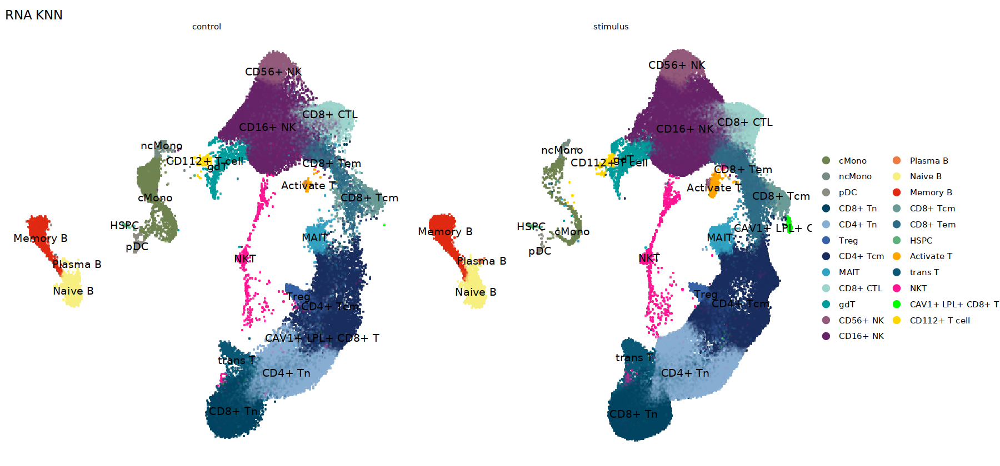

In [55]:
library(ggplot2)
options(repr.plot.width=15)
pdf("split.umap.wnn.pdf",width=15,height=6)
DimPlot(wnn.obj,reduction="wnn.umap",group.by="annotation_seurat",label=T,split.by="conditions",raster=T,pt.size=2)+coord_fixed()+NoLegend()+labs(title="RNA KNN")+scale_color_manual(values=color)+theme_void()
dev.off()
DimPlot(wnn.obj,reduction="wnn.umap",group.by="annotation_seurat",label=T,split.by="conditions",raster=T,pt.size=2)+coord_fixed()+NoLegend()+labs(title="RNA KNN")+scale_color_manual(values=color)+theme_void()


In [76]:
pdf("CD103.umap.pdf",width=13,height=6)
FeaturePlot(wnn.obj,reduction="rna.umap","CD103-Hu",raster=T,slot="counts",,max.cutoff = "q99",pt.size = 2,raster.dpi = c(1000, 1000),order=T,cols = hcl.colors(n = 5,palette = "Reds 3",rev = T)) |
FeaturePlot(wnn.obj,reduction="protein.umap","CD103-Hu",raster=T,slot="counts",,max.cutoff = "q99",pt.size = 2,raster.dpi = c(1000, 1000),order=T,cols = hcl.colors(n = 5,palette = "Reds 3",rev = T))+coord_flip() 
dev.off()

Warning message:
“Could not find CD103-Hu in the default search locations, found in Protein assay instead”
Warning message:
“Could not find CD103-Hu in the default search locations, found in Protein assay instead”


png 
  2

In [78]:
pdf("CD112.umap.pdf",width=13,height=6)
FeaturePlot(wnn.obj,reduction="rna.umap","CD112-Hu",raster=T,slot="counts",,max.cutoff = "q99",pt.size = 2,raster.dpi = c(1000, 1000),order=T,cols = hcl.colors(n = 5,palette = "Reds 3",rev = T)) |
FeaturePlot(wnn.obj,reduction="protein.umap","CD112-Hu",raster=T,slot="counts",,max.cutoff = "q99",pt.size = 2,raster.dpi = c(1000, 1000),order=T,cols = hcl.colors(n = 5,palette = "Reds 3",rev = T))+coord_flip() 
dev.off()

Warning message:
“Could not find CD112-Hu in the default search locations, found in Protein assay instead”
Warning message:
“Could not find CD112-Hu in the default search locations, found in Protein assay instead”


png 
  2

In [85]:
wnn.obj$test.group=wnn.obj$annotation_seurat=="CD112+ T cell"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



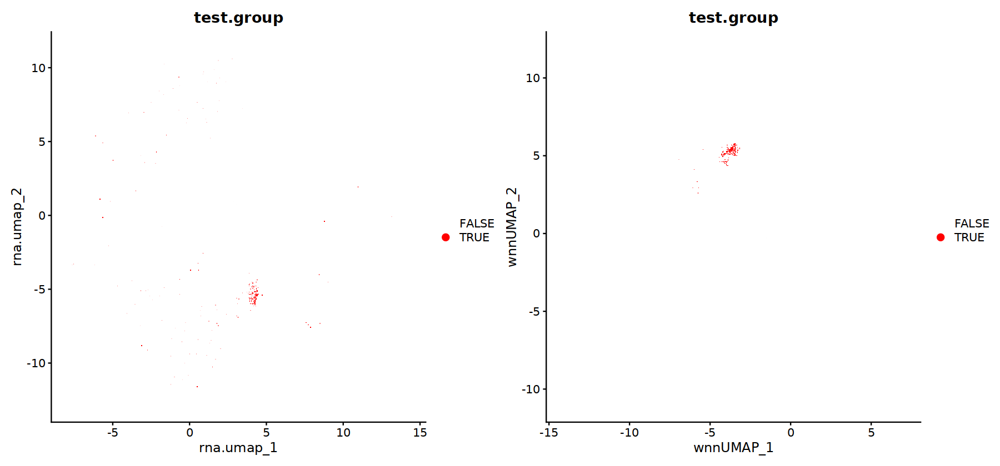

In [102]:
DimPlot(wnn.obj,group.by="test.group",reduction = "rna.umap")+scale_color_manual(values = c("transparent","red"))|DimPlot(wnn.obj,group.by="test.group",reduction="wnn.umap")+scale_color_manual(values = c("transparent","red"))

In [77]:
getwd()

[1] "/data/work/Analysis"

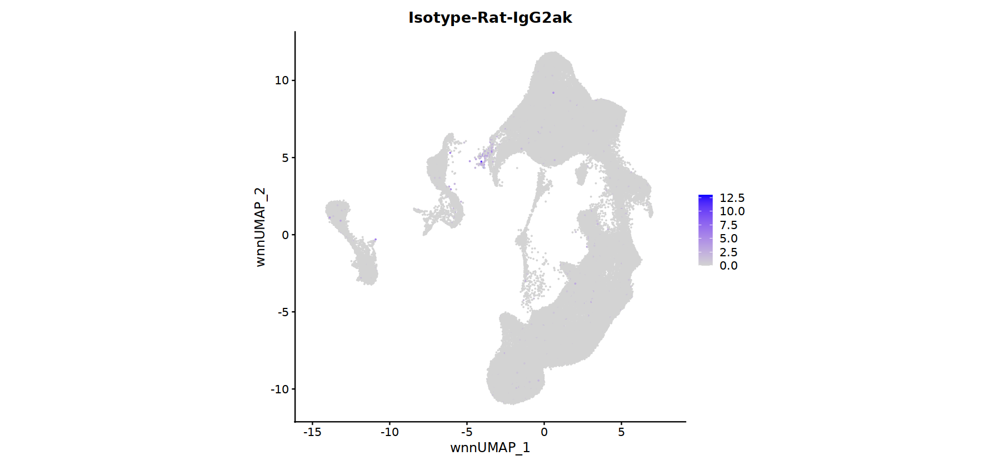

In [63]:
FeaturePlot(mer1,reduction="wnn.umap","Isotype-Rat-IgG2ak",raster=F,slot="counts")+coord_fixed() #,split.by="conditions")

In [68]:
rowSums(df[df$Gene.Name=="",])

ERROR: Error in base::rowSums(x, na.rm = na.rm, dims = dims, ...): 'x' must be numeric


In [65]:
rowSums(mer1@assays$RNA@counts[df[df$Gene.Name=="","PIDName1"],])

ERROR: Error in .subscript.2ary(x, i, , drop = TRUE): subscript out of bounds


In [16]:
rownames(df)[!grepl("-Hu",rownames(df))]

[1] "Isotype-Rat-IgG2ak" "Isotype-Ms-IgG2bk"  "Isotype-Rat-IgG1k" 
 [4] "Isotype-Ham-IgG"    "CD278-MsHu"         "Isotype-Ms-IgG2ak" 
 [7] "Isotype-Rat-IgG2bk" "Isotype-Ms-IgG1k"   "Isotype-Rat-IgG1r" 
[10] "Isotype-Rat-IgG2ck" "Integrin-b7-MsHu"   "CD44-MsHu"

In [109]:
ave1=AverageExpression(mer,assay="Protein",df[df$Gene.Name!="" & df$PIDName1!="","PIDName1" ])$Protein

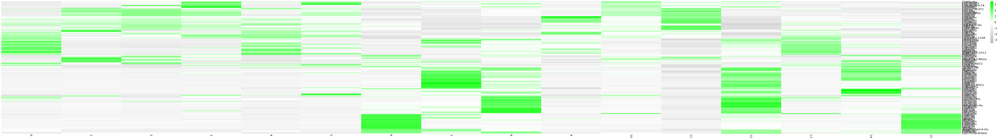

In [110]:
p=pheatmap::pheatmap(ave1,scale="row",cluster_col=F,col=colorRampPalette(colors=c("gray","white","green"))(50),border_color=NA,treeheight_row=0)
#ggsave("protein.pheatmap.pdf",plot=p)

In [111]:
ave2=AverageExpression(mer,assay="RNA",df[p$tree_row$labels[p$tree_row$order],"Gene.Name"])$RNA

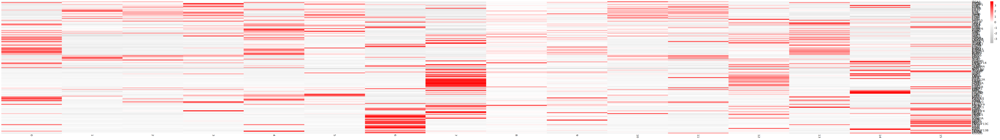

In [112]:
p2=pheatmap::pheatmap(ave2,scale="row",cluster_col=F,cluster_row=F,col=colorRampPalette(colors=c("gray","white","red"))(50),border_color=NA)
#ggsave("gene.pheatmap.pdf",plot=p2)

In [113]:
options(repr.plot.width=8,repr.plot.height=7)

In [134]:
cor_res=apply(as.matrix(1:nrow(ave1)),1,function(xx){cor(scale(ave1[df[p$tree_row$labels[p$tree_row$order],"PIDName1"],][xx,]),scale(ave2[xx,]))})
names(cor_res)=paste(rownames(ave1[df[p$tree_row$labels[p$tree_row$order],"PIDName1"],]),rownames(ave2))
#sort(cor_res,decreasing=T)

In [15]:
obj.wnn@active.assay="Protein"
obj.wnn=ScaleData(obj.wnn,verbose=F)
obj.wnn=RunPCA(obj.wnn,reduction.name="protein.pca")
library(harmony)
#mer=RunHarmony(mer,group.by.vars = "sample")
obj.wnn=RunHarmony(obj.wnn,group.by.vars = c("sample","conditions"),lambda=c(1,1),reduction.save="protein.harmony",reduction="protein.pca")
obj.wnn=RunUMAP(obj.wnn,reduction = "protein.harmony",dims = 1:20,reduction.name="protein.umap")
obj.wnn=FindNeighbors(obj.wnn,reduction="protein.harmony",dims = 1:20)
obj.wnn=FindClusters(obj.wnn)
obj.wnn$seurat_cluster_protein=obj.wnn$seurat_clusters

obj.wnn@active.assay="integrated"
obj.wnn <- ScaleData(obj.wnn, verbose = FALSE)
obj.wnn=RunPCA(obj.wnn,reduction.name="rna.pca")
obj.wnn=RunUMAP(obj.wnn,dims = 1:15,reduction.name="rna.umap",reduction="rna.pca")
obj.wnn=FindNeighbors(obj.wnn,dims = 1:15,reduction="rna.pca")
obj.wnn=FindClusters(obj.wnn)
obj.wnn$seurat_cluster_rna=obj.wnn$seurat_clusters

obj.wnn@active.assay="RNA"

00:11:43 UMAP embedding parameters a = 0.9922 b = 1.112

00:11:43 Read 149147 rows and found 15 numeric columns

00:11:43 Using Annoy for neighbor search, n_neighbors = 30

00:11:43 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

00:12:05 Writing NN index file to temp file /tmp/RtmpLVwlqs/file88540b8154

00:12:05 Searching Annoy index using 1 thread, search_k = 3000

00:13:32 Annoy recall = 100%

00:13:33 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

00:13:39 Initializing from normalized Laplacian + noise (using irlba)

00:14:07 Commencing optimization for 200 epochs, with 7020064 positive edges

00:16:05 Optimization finished

Warning message:
“Cannot add objects with duplicate keys (offending key: UMAP_), setting key to 'rna

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 149147
Number of edges: 4847256

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9008
Number of communities: 26
Elapsed time: 166 seconds


In [ ]:
obj.wnn <- FindMultiModalNeighbors(
  obj.wnn, reduction.list = list("rna.pca", "protein.harmony"), 
  dims.list = list(1:20, 1:30), modality.weight.name = "RNA.weight"
)

Calculating cell-specific modality weights

Finding 20 nearest neighbors for each modality.

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from normrna.pca_ to normrnapca_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to normrnapca_”
Calculating kernel bandwidths

Warning message in FindMultiModalNeighbors(obj.wnn, reduction.list = list("rna.pca", :
“The number of provided modality.weight.name is not equal to the number of modalities. integrated.weight Protein.weight are used to store the modality weights”
Finding multimodal neighbors

Constructing multimodal KNN graph

Constructing multimodal SNN graph



In [ ]:
obj.wnn <- RunUMAP(obj.wnn, nn.name = "weighted.nn", reduction.name = "wnn.umap", reduction.key = "wnnUMAP_")
obj.wnn <- FindClusters(obj.wnn, graph.name = "wsnn", algorithm = 3, resolution = 0.8, verbose = FALSE)

00:32:51 UMAP embedding parameters a = 0.9922 b = 1.112

00:32:53 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 20

00:32:57 Initializing from normalized Laplacian + noise (using irlba)

00:33:09 Commencing optimization for 200 epochs, with 5151236 positive edges

00:35:10 Optimization finished



In [ ]:
saveRDS(obj.wnn,"wnn2.rds")

In [3]:
obj.wnn=readRDS("wnn2.rds")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



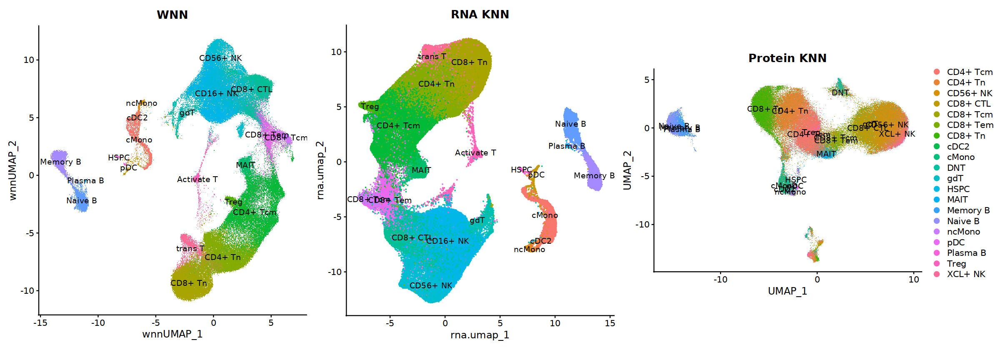

In [7]:
options(repr.plot.width=20)
p=DimPlot(obj.wnn,reduction="wnn.umap",group.by="annotation1",label=T)+coord_fixed()+NoLegend()+labs(title="WNN")|
DimPlot(subset(obj.wnn,subset=annotation1 %in% names(color)),reduction="rna.umap",group.by="annotation1",label=T,size=0.5,raster=F)+coord_fixed()+NoLegend()+labs(title="RNA KNN")|
DimPlot(obj.wnn,reduction="protein.umap",group.by="annotation",label=T)+coord_fixed()+labs(title="Protein KNN")
p

In [5]:
obj.wnn=subset(obj.wnn,cells=Cells(obj.wnn)[!is.na(obj.wnn$annotation)])

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from protein.umap_ to proteinumap_”


In [123]:
df=aggregate(as.character(obj.wnn$seurat_clusters), by=list(as.character(obj.wnn$annotation1),as.character(obj.wnn$seurat_clusters)),length)

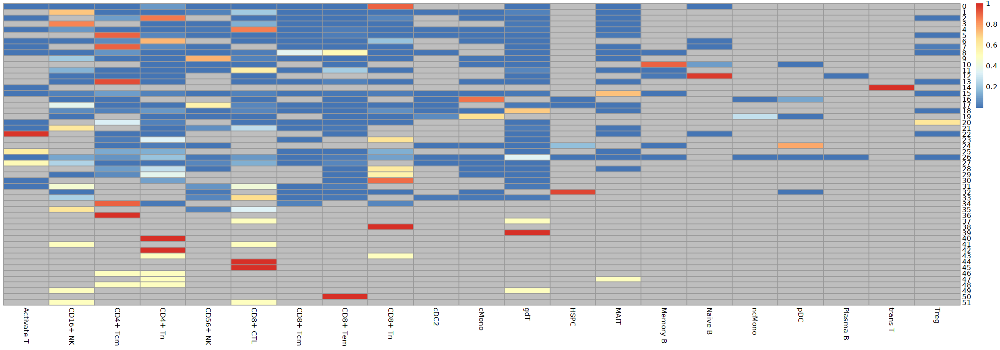

In [126]:
df1=as.data.frame(table(obj.wnn$seurat_clusters))
df2=merge(df1,df,by.x="Var1",by.y="Group.2")
df2$ratio=df2$x/df2$Freq
 options(digits=2)
mat=reshape2::dcast(df2,Var1~Group.1,value.var="ratio")
rownames(mat)=mat$Var1
mat=mat[,-1]
pheatmap::pheatmap(mat,na_col="gray",cluster_col=F,cluster_row=F)

In [176]:
res=apply(as.matrix(mat),1,FUN=function(xx){any(xx>0.7)})
mat1=mat[names(res[!is.na(res)]),]
res1=apply(as.matrix(mat1),1,FUN=function(xx){colnames(mat1)[which(xx>0.51)]})
obj.wnn$annotation_seurat=plyr::mapvalues(obj.wnn$seurat_clusters,from=names(res1),to=res1)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



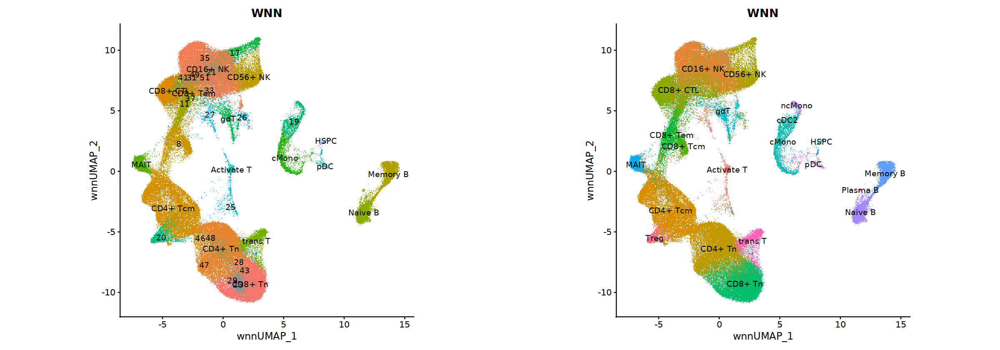

In [177]:
options(repr.plot.width=20)
p=DimPlot(obj.wnn,reduction="wnn.umap",group.by="annotation_seurat",label=T)+coord_fixed()+NoLegend()+labs(title="WNN")|
DimPlot(obj.wnn,reduction="wnn.umap",group.by="annotation1",label=T)+coord_fixed()+NoLegend()+labs(title="WNN")
p

In [ ]:
options(repr.plot.width=20)
p=DimPlot(obj.wnn,reduction="wnn.umap",group.by="seurat_clusters",label=T)+coord_fixed()+NoLegend()+labs(title="WNN")|
DimPlot(subset(obj.wnn,subset=annotation1 %in% names(color)),reduction="rna.umap",group.by="annotation1",label=T,size=0.5,raster=T)+coord_fixed()+NoLegend()+labs(title="RNA KNN")|
DimPlot(obj.wnn,reduction="protein.umap",group.by="annotation",label=T)+coord_fixed()+labs(title="Protein KNN")
p

In [73]:
saveRDS(obj.wnn,"wnn1.rds")

In [3]:
obj.wnn=readRDS("wnn1.rds")

In [38]:
meta=read.csv("CITE-seq-metadata.csv",row.names=1,header=T)

In [39]:
obj.wnn$annotation=meta[rownames(obj.wnn@meta.data),"seurat_annotations"]

In [45]:
obj.wnn$seurat_cluster_rna=obj.combined@meta.data[rownames(obj.combined@meta.data),"seurat_clusters"]

In [44]:
obj.wnn$seurat_cluster_protein=mer@meta.data[rownames(mer@meta.data),"seurat_clusters"]

In [55]:
saveRDS(obj.wnn,file="wnn.rds")

In [3]:
obj.wnn=readRDS("wnn.rds")

In [67]:
obj.wnn$annotation1=obj.wnn$annotation
obj.wnn$annotation1[obj.wnn$annotation=="XCL+ NK"]="CD56+ NK"
obj.wnn$annotation1[obj.wnn$annotation=="CD56+ NK"]="CD16+ NK"
obj.wnn$annotation1[obj.wnn$seurat_clusters=="14"]="trans T"
obj.wnn$annotation1[obj.wnn$annotation=="DNT"]="Activate T"

In [50]:
table(obj.wnn$annotation1)


Activate T   CD16+ NK   CD4+ Tcm    CD4+ Tn   CD56+ NK   CD8+ CTL   CD8+ Tcm 
      1893      25990      20925      20696       6900      17414       2192 
  CD8+ Tem    CD8+ Tn       cDC2      cMono        gdT       HSPC       MAIT 
      5155      21810        155       3438       3492        295       2817 
  Memory B    Naive B     ncMono        pDC   Plasma B    trans T       Treg 
      4589       5009        581        563         39       3471       1840 

In [5]:
color=list("cMono"=rgb(111/256,132/256,81/256),
"cDC2"=rgb(163/256,181/256,0),
"ncMono"=rgb(118/256,141/256,128/256),
"pDC"=rgb(142/256,141/256,131/256),
"CD8+ Tn"=rgb(0,68/256,97/256),
"CD4+ Tn"=rgb(136/256,175/256,211/256),
"Treg"=rgb(55/256,98/256,167/256),
"CD4+ Tcm"=rgb(25/256,45/256,94/256),
"CD4+ Tem"=rgb(0,110/256,142/256),
"MAIT"=rgb(50/256,164/256,195/256),
"CD8+ CTL"=rgb(158/256,213/256,205/256),
"gdT"=rgb(0,157/256,157/256),
"CD56+ NK"=rgb(148/256,90/256,123/256),
"CD16+ NK"=rgb(103/256,35/256,104/256),
"Plasma B"=rgb(238/256,121/256,67/256),
"Naive B"=rgb(248/256,240/256,129/256),
"Memory B"=rgb(226/256,41/256,18/256),
"CD8+ Tcm"=rgb(106/256,156/256,152/256),
"CD8+ Tem"=rgb(46/256,108/256,135/256),
"HSPC"=rgb(95/256,176/256,127/256),
"Activate T"="orange",
"trans T"="navy")
obj.wnn$annotation1=factor(obj.wnn$annotation1,levels=names(color))

In [157]:
markers=readRDS("protein_harmony.marker.rds")

In [6]:
obj.wnn$annotation_protein=as.character(obj.wnn$seurat_cluster_protein)
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==6]="B cell"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==15]="TR B cell"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==10]="TR T cell"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==13]="TR NK"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==12]="TR Mono"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==7]="Mono"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==8]="CD112+ T(migration)"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==9]="Activate T"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein %in% c(1,11)]="CD8+ Tn"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==2]="CD4+ Tn"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==3]="CD4+ Tcm"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==5]="CD8+ Tcm"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==4]="CD8+ CTL"
obj.wnn$annotation_protein[obj.wnn$seurat_cluster_protein==0]="NK"

In [197]:
names(color1) %in% unique(obj.wnn$annotation_protein)

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

In [7]:
color1=list("Mono"=rgb(111/256,132/256,81/256),
"CD8+ Tn"=rgb(0,68/256,97/256),
"CD4+ Tn"=rgb(136/256,175/256,211/256),
"CD4+ Tcm"=rgb(25/256,45/256,94/256),
"CD8+ CTL"=rgb(158/256,213/256,205/256),
"NK"=rgb(103/256,35/256,104/256),
"B cell"=rgb(248/256,240/256,129/256),
"CD8+ Tcm"=rgb(106/256,156/256,152/256),
"Activate T"="orange",
"CD112+ T(migration)"="red",
"TR Mono"=rgb(111*0.8/256,132*1.2/256,81*1.2/256),
"TR B cell"=rgb(248*0.8/256,240*1.01/256,129*1.2/256),
"TR NK"=rgb(103*0.8/256,35/256,104*1.2/256),
"TR T cell"=rgb(0,68*0.8/256,97*1.2/256)
)
obj.wnn$annotation_protein=factor(obj.wnn$annotation_protein,levels=names(color1))

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



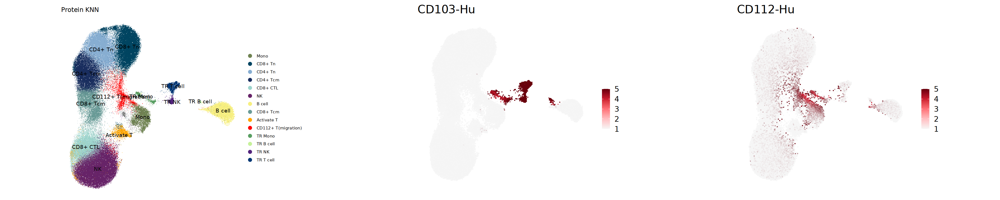

In [213]:
p1=DimPlot(obj.wnn,reduction="protein_umap",group.by="annotation_protein",label=T)+coord_fixed()+labs(title="Protein KNN")+scale_color_manual(values=color1)+theme_void()
p2=FeaturePlot(protein,features = "CD103-Hu",ncol = 1,reduction="umap",max.cutoff = "q99",pt.size = 2,order=T,cols = hcl.colors(n = 5,palette = "Reds 3",rev = T),raster = T)+theme_void()+
    theme(text=element_text(size=20))+coord_fixed()
p3=FeaturePlot(protein,features = "CD112-Hu",ncol = 1,reduction="umap",max.cutoff = "q99",pt.size = 2,order=T,cols = hcl.colors(n = 5,palette = "Reds 3",rev = T),raster = T)+theme_void()+
    theme(text=element_text(size=20))+coord_fixed()
p=p1|p2|p3
p
ggsave("protein.umap.feature.pdf",width=20,height=6,plot=p)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



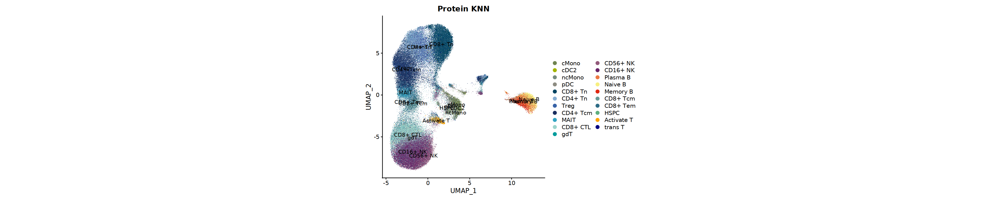

In [148]:
DimPlot(obj.wnn,reduction="protein_umap",group.by="annotation1",label=T)+coord_fixed()+labs(title="Protein KNN")+scale_color_manual(values=color)

In [211]:
df=as.data.frame(obj.wnn@reductions$protein_umap@cell.embeddings)
df$annotation=obj.wnn$annotation_protein
df$annotation=factor(df$annotation,levels=names(color1))
png("Protein_KNN.umap.png",height=1000,width=1000)
ggplot(df,aes(UMAP_1,UMAP_2,color=annotation),size=0.5)+geom_point(alpha=0.6)+coord_fixed()+labs(title="RNA KNN")+scale_color_manual(values=color1)+theme_void()
dev.off()

png 
  2

In [5]:
protein=readRDS("clean_protein_harmony.rds")

In [10]:
table(obj.wnn$annotation_protein)


               Mono             CD8+ Tn             CD4+ Tn            CD4+ Tcm 
               6115               26639               20839               18705 
           CD8+ CTL                  NK              B cell            CD8+ Tcm 
              14954               37569               10009               11810 
         Activate T CD112+ T(migration)             TR Mono           TR B cell 
               3041                3329                 860                 228 
              TR NK           TR T cell 
                809                1992 

In [11]:
protein$annotation=obj.wnn@meta.data[rownames(protein@meta.data),"annotation_protein"]

In [ ]:
table(protein$sample)

In [12]:
table(protein$annotation)


               Mono             CD8+ Tn             CD4+ Tn            CD4+ Tcm 
               6115               26639               20839               18705 
           CD8+ CTL                  NK              B cell            CD8+ Tcm 
              14954               37569               10009               11810 
         Activate T CD112+ T(migration)             TR Mono           TR B cell 
               3041                3329                 860                 228 
              TR NK           TR T cell 
                809                1992 

In [223]:
table(protein$conditions)


 control stimulus 
   56817   100662 

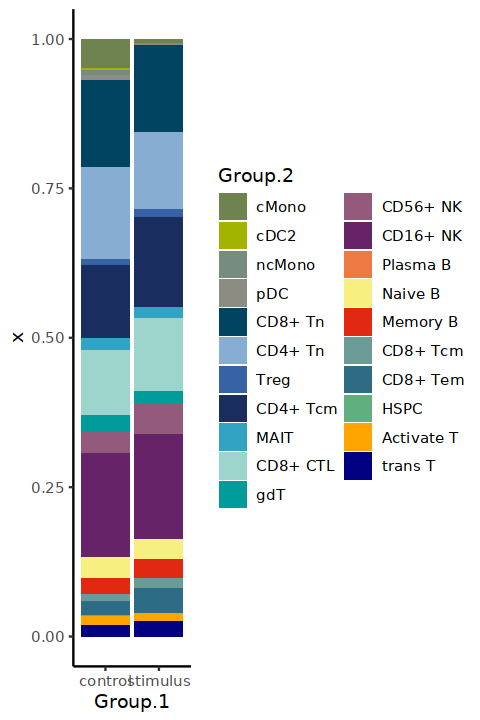

In [237]:
df=aggregate(obj.wnn$annotation1,by=list(obj.wnn$conditions,obj.wnn$annotation1),FUN=length)
options(repr.plot.width=4)
p=ggplot(df,aes(x=Group.1,y=x,fill=Group.2))+geom_bar(stat="identity",position="fill")+scale_fill_manual(values=color)+theme_classic()
p
ggsave("cell_ratio.bar.pdf",width=6,height=4,plot=p)

In [241]:
stimulus_marker$num=1:nrow(stimulus_marker)

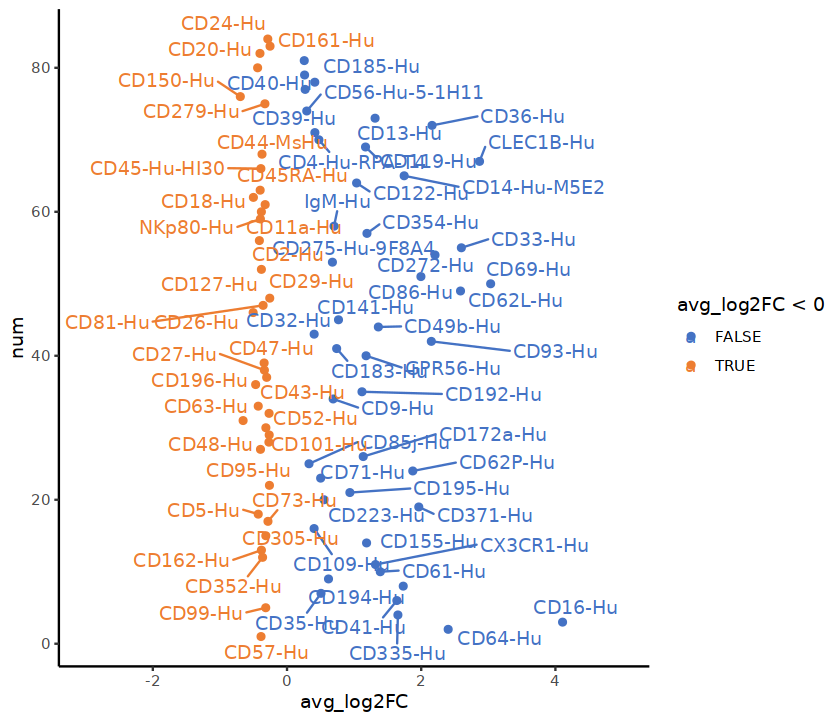

In [261]:
options(repr.plot.width=7)
p=ggplot(stimulus_marker,aes(x=avg_log2FC,y=num,color=avg_log2FC<0,label=rownames(stimulus_marker)))+geom_point()+theme_classic()+ggrepel::geom_text_repel()+xlim(-3,5)+ggthemes::scale_color_excel_new()
p
ggsave("stimulus.marker.dot.pdf",width=8,height=8,plot=p)

In [13]:
table(protein$annotation)


               Mono             CD8+ Tn             CD4+ Tn            CD4+ Tcm 
               6115               26639               20839               18705 
           CD8+ CTL                  NK              B cell            CD8+ Tcm 
              14954               37569               10009               11810 
         Activate T CD112+ T(migration)             TR Mono           TR B cell 
               3041                3329                 860                 228 
              TR NK           TR T cell 
                809                1992 

In [15]:
Tstimulus_marker

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CD16-Hu,0,4.4918977,0.553,0.016,0
CD99-Hu,0,-0.3091504,0.999,0.992,0
CD31-Hu,0,-0.2673602,0.949,0.909,0
CD41-Hu,0,1.8377096,0.712,0.166,0
Ig-light-chain-k-Hu,0,1.7371809,0.502,0.122,0
CD61-Hu,0,1.6192361,0.750,0.206,0
CD352-Hu,0,-0.3203051,0.994,0.983,0
CD162-Hu,0,-0.3483203,0.998,0.996,0
CD305-Hu,0,-0.3107611,0.988,0.970,0


In [23]:
res=apply(as.matrix(unique(protein$annotation)),1,function(xx){
 df=FindMarkers(subset(protein,annotation %in% c(xx)),ident.1="control",ident.2="stimulus",group.by="conditions")
 df$celltype=xx
    df
})

In [26]:
res_df=do.call("rbind",res)

In [29]:
write.csv(res_df,"protein_marker.csv")

In [225]:
stimulus_marker=FindMarkers(protein,ident.1="control",ident.2="stimulus",group.by="conditions")

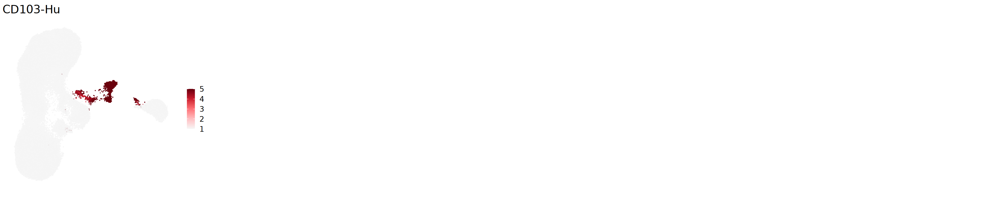

In [156]:
FeaturePlot(protein,features = "CD103-Hu",ncol = 5,reduction="umap",max.cutoff = "q99",pt.size = 2,order=T,cols = hcl.colors(n = 5,palette = "Reds 3",rev = T),raster = T)+theme_void()+
    theme(text=element_text(size=20))+coord_fixed()

In [133]:
colnames(obj.wnn@meta.data)

[1] "orig.ident"             "nCount_RNA"             "nFeature_RNA"          
 [4] "area"                   "perimeter"              "Cx"                    
 [7] "Cy"                     "AR"                     "solidity"              
[10] "roundness"              "circularity"            "cell"                  
[13] "scDblFinder.class"      "nCount_Protein"         "nFeature_Protein"      
[16] "RNA_snn_res.0.8"        "seurat_clusters"        "seurat_cluster_rna"    
[19] "Protein_snn_res.0.8"    "seurat_cluster_protein" "sample"                
[22] "RNA_snn_res.0.3"        "conditions"             "Protein_snn_res.0.3"   
[25] "percent.mt"             "percent.ribo"           "integrated_snn_res.0.8"
[28] "integrated.weight"      "Protein.weight"         "wsnn_res.0.8"          
[31] "annotation"             "annotation1"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



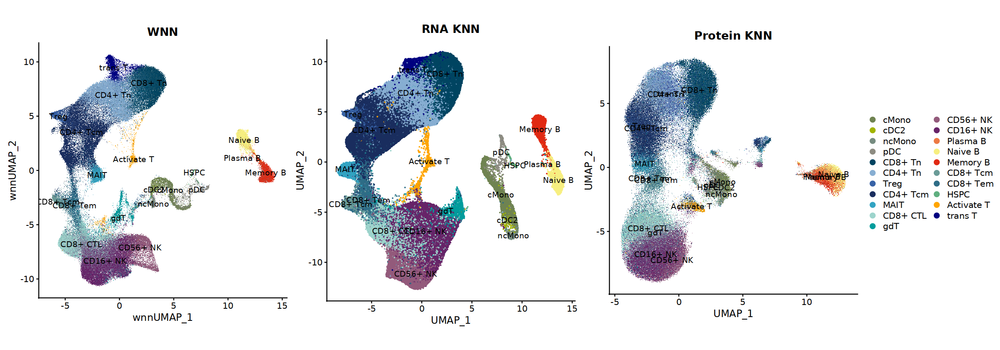

In [80]:
options(repr.plot.width=20)
p=DimPlot(obj.wnn,reduction="wnn.umap",group.by="annotation1",label=T)+coord_fixed()+NoLegend()+labs(title="WNN")+scale_color_manual(values=color)|
DimPlot(subset(obj.wnn,subset=annotation1 %in% names(color)),reduction="umap",group.by="annotation1",label=T,size=0.5,raster=F)+coord_fixed()+NoLegend()+labs(title="RNA KNN")+scale_color_manual(values=color)|
DimPlot(obj.wnn,reduction="protein_umap",group.by="annotation1",label=T)+coord_fixed()+labs(title="Protein KNN")+scale_color_manual(values=color)
p

TableGrob (1 x 5) "arrange": 5 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (1-1,3-3) arrange gtable[layout]
4 4 (1-1,4-4) arrange gtable[layout]
5 5 (1-1,5-5) arrange gtable[layout]

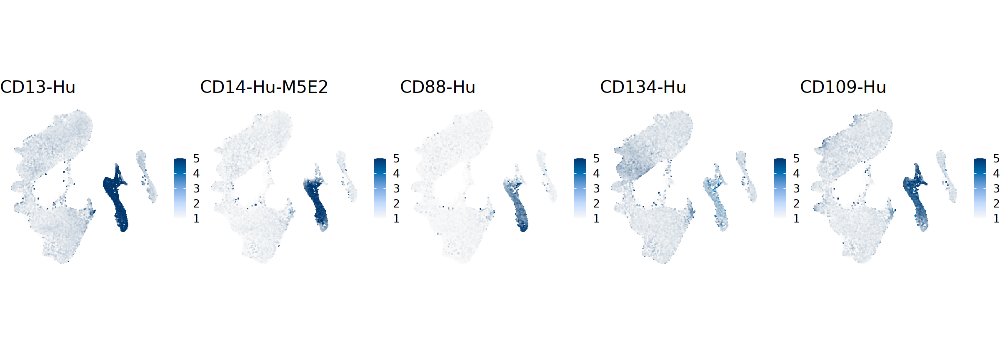

In [127]:
plist=lapply(as.list(c("CD13-Hu","CD14-Hu-M5E2","CD88-Hu","CD134-Hu","CD109-Hu")),function(xx){
FeaturePlot(obj.wnn,features = xx,ncol = 5,reduction="umap",max.cutoff = "q99",pt.size = 3,order=T,cols = hcl.colors(n = 5,palette = "Blues 3",rev = T),raster = T)+theme_void()+
    theme(text=element_text(size=20))+coord_fixed()}
       )
library(patchwork)
p=gridExtra::grid.arrange(grobs = plist, layout_matrix = t(matrix(c(1,2,3,4,5))))
p
ggsave("monocyte.marker.featureplot.pdf",width=20,height=4,plot=p)

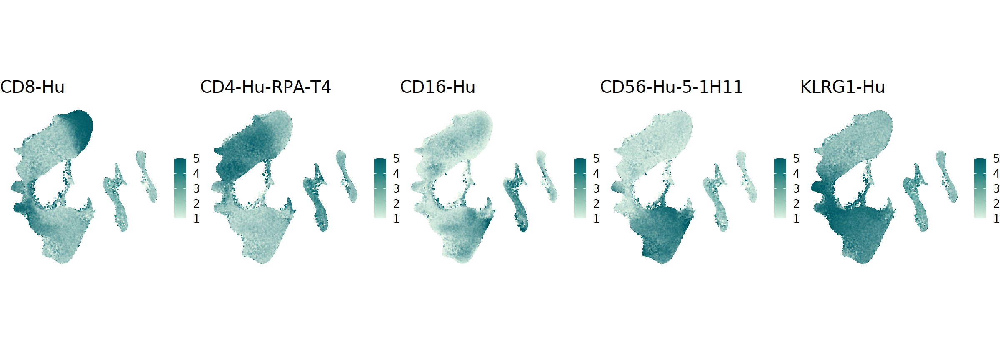

In [128]:
plist=lapply(as.list(c("CD8-Hu","CD4-Hu-RPA-T4","CD16-Hu","CD56-Hu-5-1H11","KLRG1-Hu")),function(xx){
FeaturePlot(obj.wnn,features = xx,ncol = 5,reduction="umap",max.cutoff = "q99",pt.size = 3,order=T,cols = hcl.colors(n = 5,palette = "Mint",rev = T),raster = T)+theme_void()+
    theme(text=element_text(size=20))+coord_fixed()}
       )
library(patchwork)
p=gridExtra::grid.arrange(grobs = plist, layout_matrix = t(matrix(c(1,2,3,4,5))))
ggsave("Tcell.marker.featureplot.pdf",width=20,height=4,plot=p)

In [ ]:
options(repr.plot.width=30,repr.plot.height=6)
plist=lapply(as.list(c("CD19-Hu","CD72-Hu","IgD-Hu","CD24-Hu",'CD1c-Hu')),function(xx){
FeaturePlot(obj.wnn,features = xx,ncol = 5,reduction="umap",max.cutoff = "q99",pt.size = 3,order=T,cols = hcl.colors(n = 5,palette = "BrwnYl",rev = T),raster = T)+theme_void()+
    theme(text=element_text(size=20))}
       )
library(patchwork)
p=gridExtra::grid.arrange(grobs = plist, layout_matrix = t(matrix(c(1,2,3,4,5))))
ggsave("Bcell.marker.featureplot.pdf",width=20,height=4,plot=p)

ERROR: Error in Key(object = object[[reduction]]): object 'control' not found


In [109]:
df=as.data.frame(obj.wnn@reductions$umap@cell.embeddings)
df$annotation=obj.wnn$annotation1
df$annotation=factor(df$annotation,levels=names(color))
png("RNA_KNN.umap.png",height=1000,width=1000)
ggplot(df,aes(UMAP_1,UMAP_2,color=annotation),size=0.5)+geom_point(alpha=0.6)+coord_fixed()+labs(title="RNA KNN")+scale_color_manual(values=color)+theme_void()
dev.off()

png 
  2

In [79]:
ggsave("DimPlot.pdf",width=20,height=6,plot=p)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



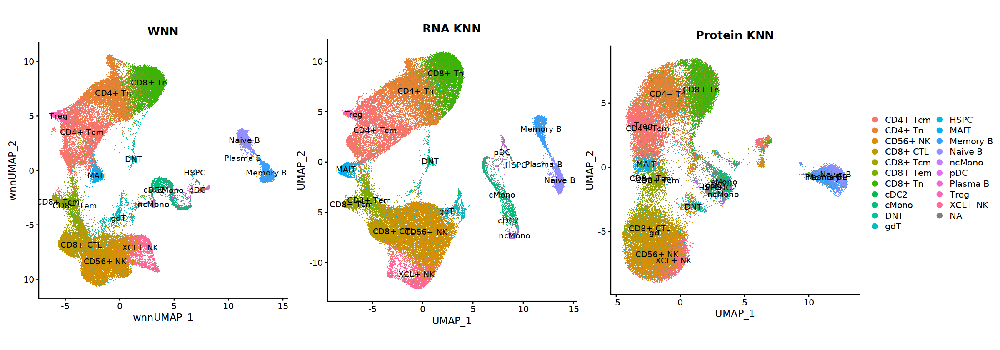

In [6]:
options(repr.plot.width=20)
DimPlot(obj.wnn,reduction="wnn.umap",group.by="annotation",label=T)+coord_fixed()+NoLegend()+labs(title="WNN")|
DimPlot(obj.wnn,reduction="umap",group.by="annotation",label=T)+coord_fixed()+NoLegend()+labs(title="RNA KNN")|
DimPlot(obj.wnn,reduction="protein_umap",group.by="annotation",label=T)+coord_fixed()+labs(title="Protein KNN")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



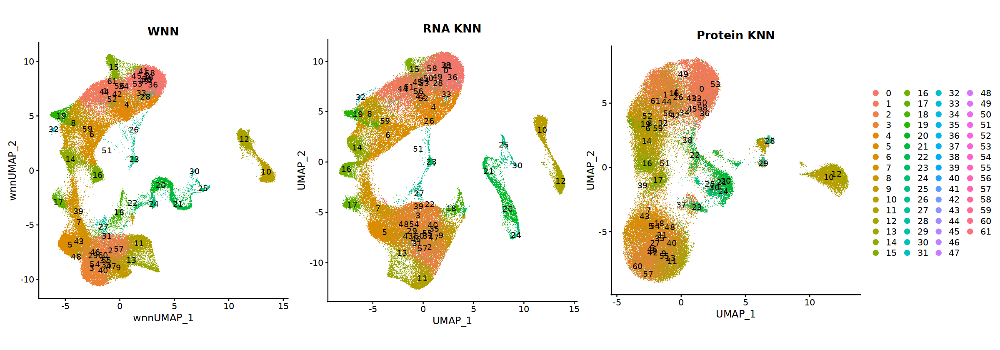

In [7]:
options(repr.plot.width=20)
DimPlot(obj.wnn,reduction="wnn.umap",group.by="seurat_clusters",label=T)+coord_fixed()+NoLegend()+labs(title="WNN")|
DimPlot(obj.wnn,reduction="umap",group.by="seurat_clusters",label=T)+coord_fixed()+NoLegend()+labs(title="RNA KNN")|
DimPlot(obj.wnn,reduction="protein_umap",group.by="seurat_clusters",label=T)+coord_fixed()+labs(title="Protein KNN")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



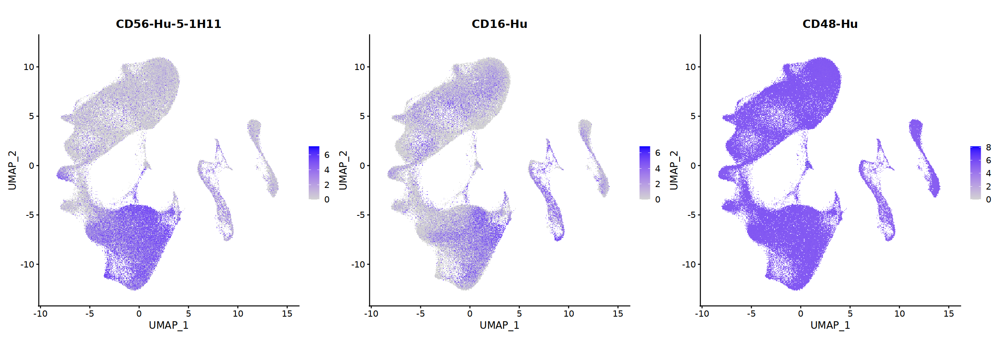

In [114]:
obj.wnn@active.assay="Protein"
FeaturePlot(obj.wnn,"CD56-Hu-5-1H11")+coord_fixed()|FeaturePlot(obj.wnn,"CD16-Hu")+coord_fixed()|FeaturePlot(obj.wnn,"CD48-Hu",order=T)+coord_fixed()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



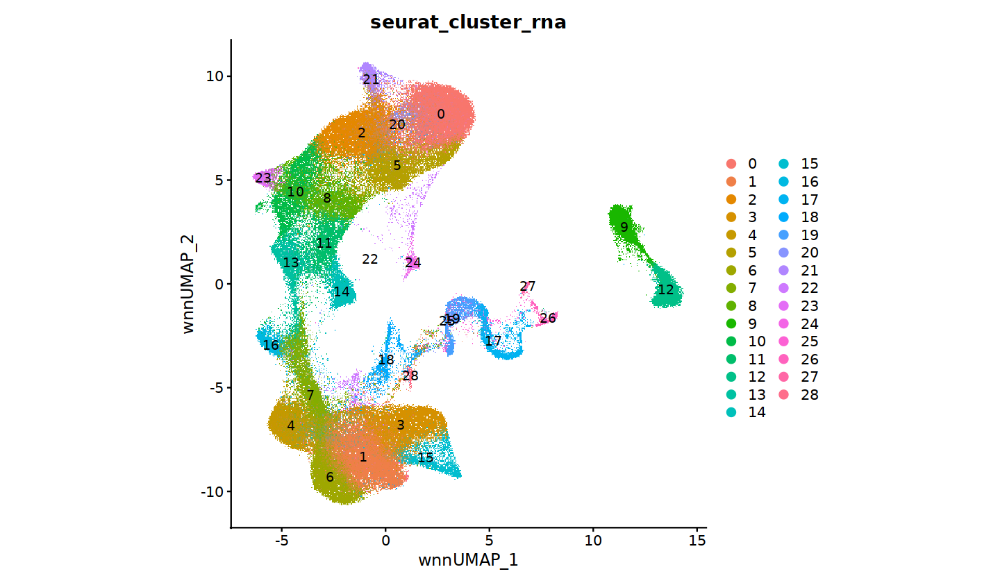

In [46]:
DimPlot(obj.wnn,reduction="wnn.umap",group.by="seurat_cluster_rna",label=T)+coord_fixed()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



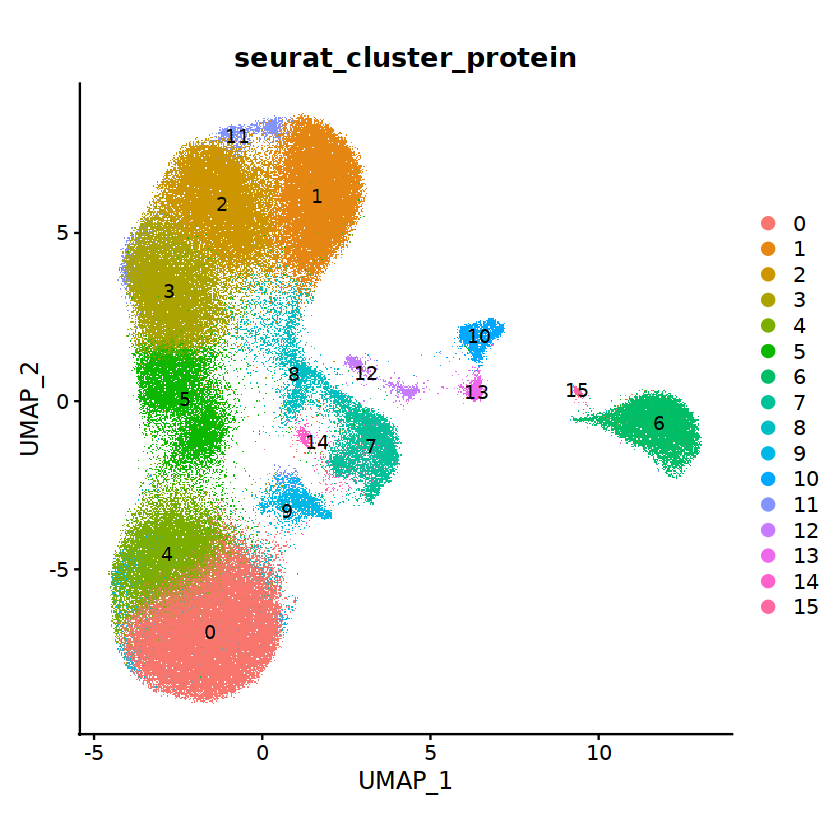

In [9]:
DimPlot(obj.wnn,reduction="protein_umap",group.by="seurat_cluster_protein",label=T)+coord_fixed()

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



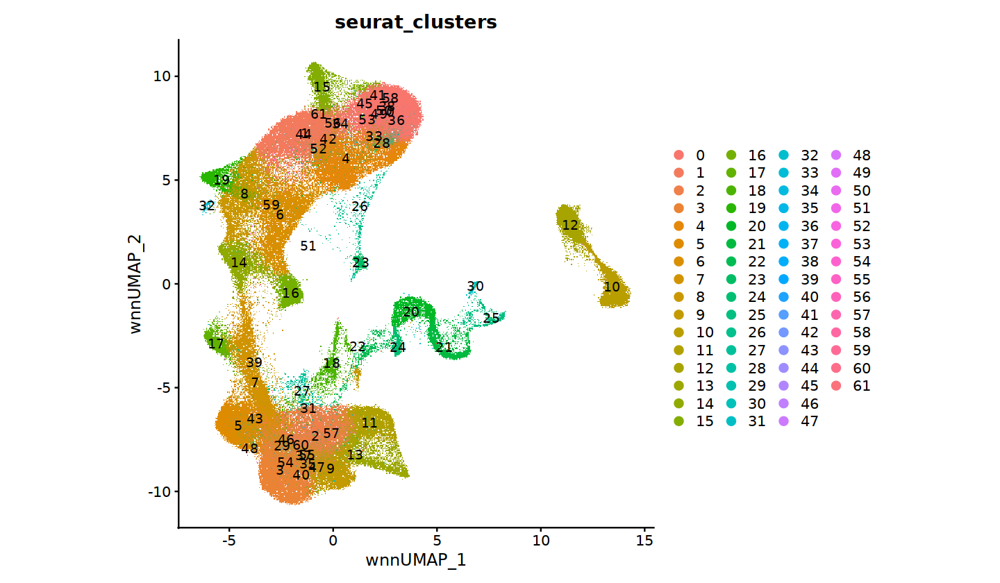

In [36]:
options(repr.plot.width=12)
DimPlot(obj.wnn,reduction="wnn.umap",group.by="seurat_clusters",label=T)+coord_fixed()

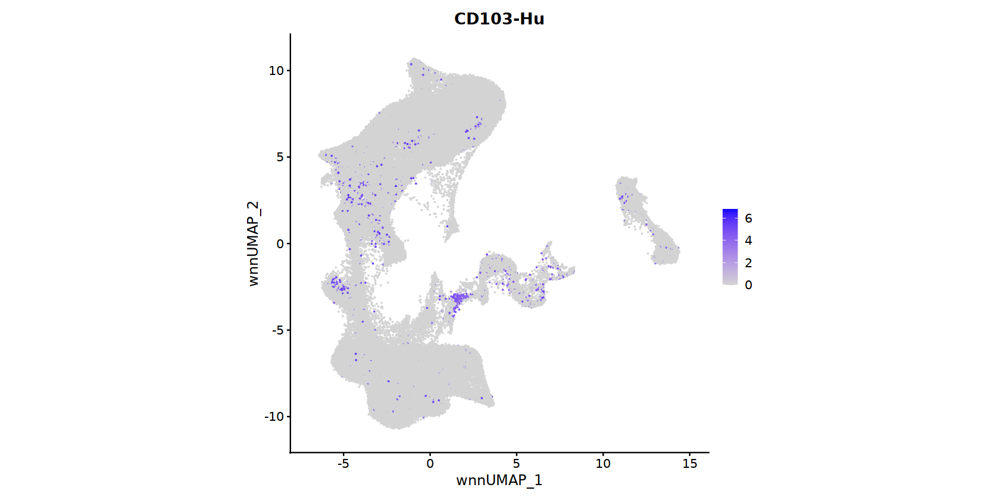

In [26]:
FeaturePlot(obj.wnn,"CD103-Hu",raster=F,reduction="wnn.umap")+coord_fixed()

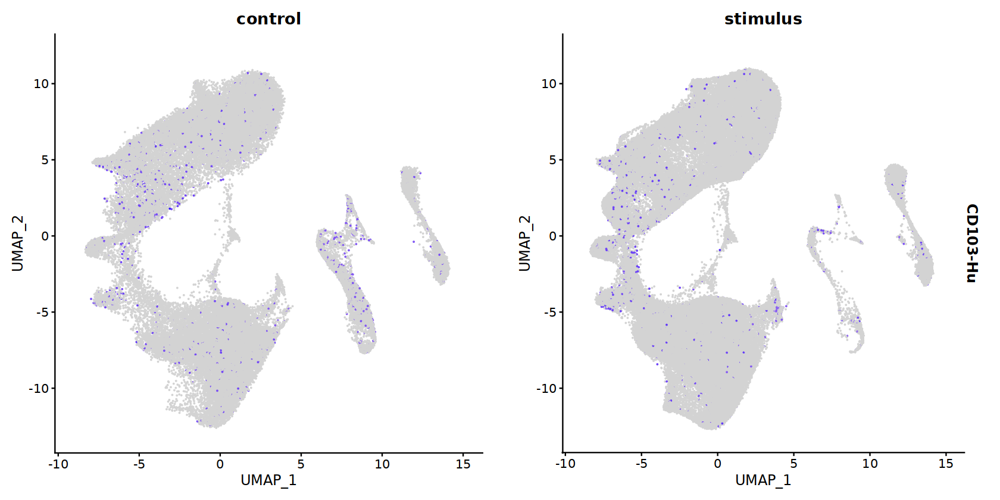

In [32]:
FeaturePlot(obj.wnn,"CD103-Hu",raster=F,reduction="protein_umap",split.by="conditions")+coord_fixed()

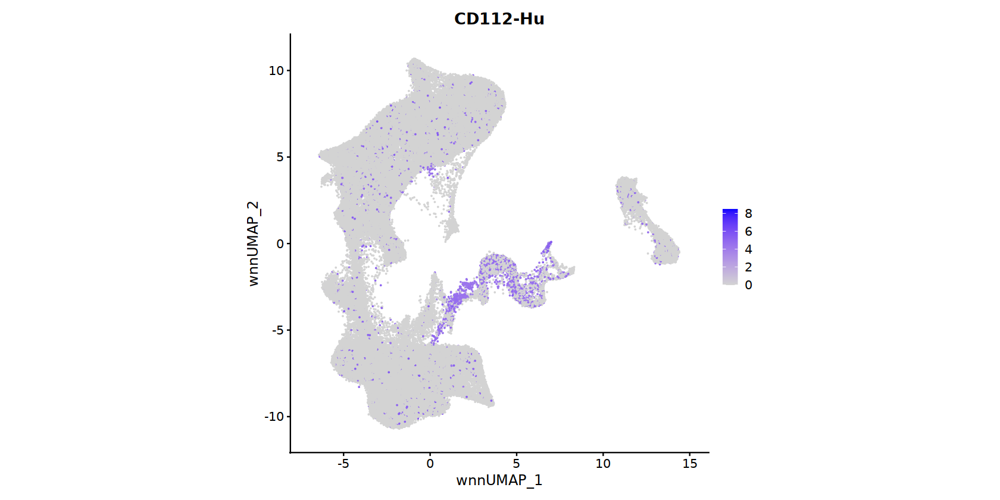

In [28]:
FeaturePlot(obj.wnn,"CD112-Hu",order=F,raster=F,reduction="wnn.umap")+coord_fixed()

In [91]:
obj.wnn@active.assay="RNA"

In [2]:
library(CiteFuse)
library(scater)
library(SingleCellExperiment)
library(DT)

Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘matrixStats’


The following object is masked from ‘package:plyr’:

    count


The following object is masked from ‘package:dplyr’:

    count



Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians, colWeightedSds,
    colWeightedVars, rowAlls, rowAnyNAs, rowAnys, rowAvgsPerColSet,
    rowCollapse, rowCounts, rowC

In [216]:
gc()
obj.fuse=as.SingleCellExperiment(obj.wnn,assay=c("RNA","Protein"))

,used,(Mb),gc trigger,(Mb),max used,(Mb)
Ncells,8893560,475.0,15101357,806.5,15101357,806.5
Vcells,2868435644,21884.5,5516882414,42090.5,5108302434,38973.3


In [218]:
obj.fuse

class: SingleCellExperiment 
dim: 146 157479 
metadata(0):
assays(3): counts logcounts scaledata
rownames(146): CD134-Hu CD21-Hu ... CD13-Hu CD25-Hu
rowData names(0):
colnames(157479): B04250E4_C8160 B04250E4_C9518 ... Y00724P6_C2380
  Y00724P6_C9403
colData names(34): orig.ident nCount_RNA ... annotation_protein ident
reducedDimNames(6): PCA UMAP ... PROTEIN_PCA WNN.UMAP
mainExpName: Protein
altExpNames(1): RNA

In [27]:
obj.wnn@active.assay="RNA"
RNAmarker10=FindMarkers(obj.wnn,group.by="seurat_cluster_protein",ident.1=10)

In [37]:
obj.wnn@active.assay="Protein"
Proteinmarker10=FindMarkers(obj.wnn,group.by="seurat_cluster_protein",ident.1=10)

In [214]:
marker1=readRDS("protein_harmony.marker.rds")

In [215]:
marker2=readRDS("protein_harmony.RNAmarker.rds")

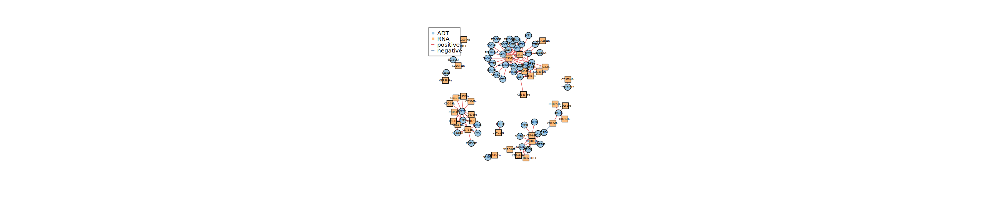

In [221]:
res=geneADTnetwork(obj.fuse,
               ADT_feature_subset = unique(marker2[marker2$avg_log2FC>1,"gene"]),
               RNA_feature_subset = unique(marker1[marker1$avg_log2FC>1,"gene"]),
               cor_method = "pearson",
               altExp_name = "RNA",
               RNA_exprs_value = "counts",
               altExp_exprs_value = "counts",
               return_igraph = T,
               cor_threshold = 0.32,
               network_layout = igraph::layout_with_fr
              )

In [222]:
pdf("network.pdf"); plot(res, vertex.size=6);dev.off()

png 
  2

In [60]:
test=mer@assays$Protein[df1$PIDName1[df1$PIDName1 %in% rownames(mer@assays$Protein@counts)]]
mer[["Protein"]]=CreateAssayObject(test)

In [61]:
mer@active.assay="Protein"
mer=NormalizeData(mer,verbose = F)
VariableFeatures(mer)=rownames(mer@assays$Protein@counts)
mer=ScaleData(mer,verbose=F)
mer=RunPCA(mer)
library(harmony)
#mer=RunHarmony(mer,group.by.vars = "sample")
mer=RunHarmony(mer,group.by.vars = c("sample","conditions"),lambda=c(1,1))
mer=RunUMAP(mer,reduction = "harmony",dims = 1:20)
mer=FindNeighbors(mer,reduction="harmony",dims = 1:20)
mer=FindClusters(mer)

PC_ 1 
Positive:  CD48-Hu, CD45-Hu-HI30, CD45RA-Hu, CD162-Hu, CD11a-Hu, CD2-Hu, CD81-Hu, CD99-Hu, CD352-Hu, HLA-A-B-C-Hu 
	   CD5-Hu, CD127-Hu, CD27-Hu, CD26-Hu, CD28-Hu, CD3-Hu-UCHT1, CD278-MsHu, CD43-Hu, CD47-Hu, CD196-Hu 
	   CD94-Hu, CD7-Hu, CD305-Hu, CD52-Hu, CD44-MsHu, CD18-Hu, NKp80-Hu, CD161-Hu, CD314-Hu, CD8-Hu 
Negative:  CD33-Hu, Ig-light-chain-k-Hu, CD64-Hu, CD93-Hu, CD13-Hu, CD371-Hu, CD62P-Hu, CD32-Hu, CD36-Hu, CD86-Hu 
	   CD14-Hu-M5E2, CD35-Hu, CD41-Hu, CD16-Hu, CD61-Hu, CLEC1B-Hu, CD354-Hu, CD39-Hu, CD40-Hu, CD192-Hu 
	   CD141-Hu, CD49b-Hu, IgM-Hu, CD172a-Hu, CD88-Hu, CD155-Hu, CX3CR1-Hu, CD69-Hu, CD62L-Hu, CD85j-Hu 
PC_ 2 
Positive:  CD94-Hu, NKp80-Hu, CD56-Hu-5-1H11, CD244-Hu, CD328-Hu, CD151-Hu, GPR56-Hu, CD11c-Hu, CD57-Hu, CD63-Hu 
	   KLRG1-Hu, CD11b-Hu, CD161-Hu, CD43-Hu, CD319-Hu, TIGIT-Hu, CD58-Hu, CD172a-Hu, CD226-Hu-11A8, CD95-Hu 
	   CD18-Hu, CD16-Hu, CX3CR1-Hu, CD335-Hu, CD107a-Hu, CD29-Hu, CD314-Hu, CD122-Hu, CD45RA-Hu, CD158e1-Hu 
Negative:  CD28-Hu, CD2

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 157479
Number of edges: 2841510

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8643
Number of communities: 25
Elapsed time: 84 seconds


9 singletons identified. 16 final clusters.



Warning message:
“Could not find CD103-Hu in the default search locations, found in Protein assay instead”


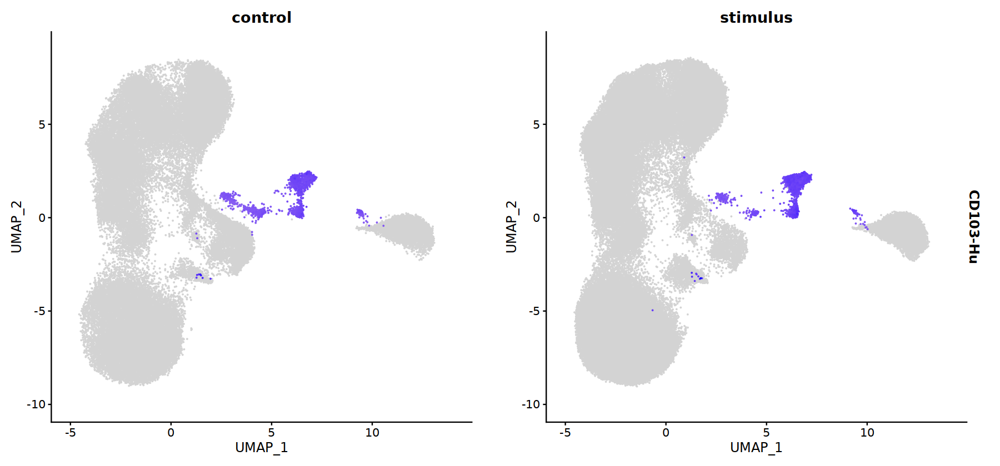

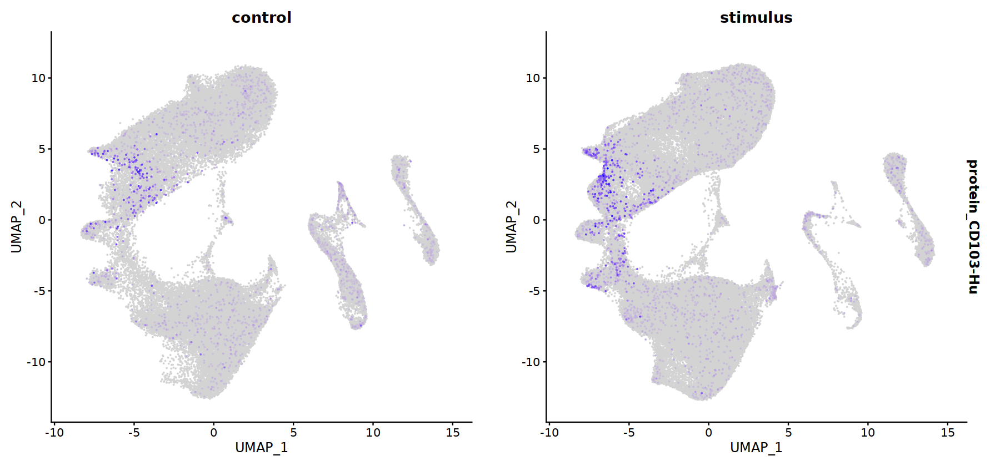

In [70]:
FeaturePlot(mer,"CD103-Hu",split.by="conditions",raster=F,order=T)
FeaturePlot(obj.combined,"CD103-Hu",split.by="conditions",raster=F,order=T)

Warning message:
“Could not find CD19 in the default search locations, found in RNA assay instead”


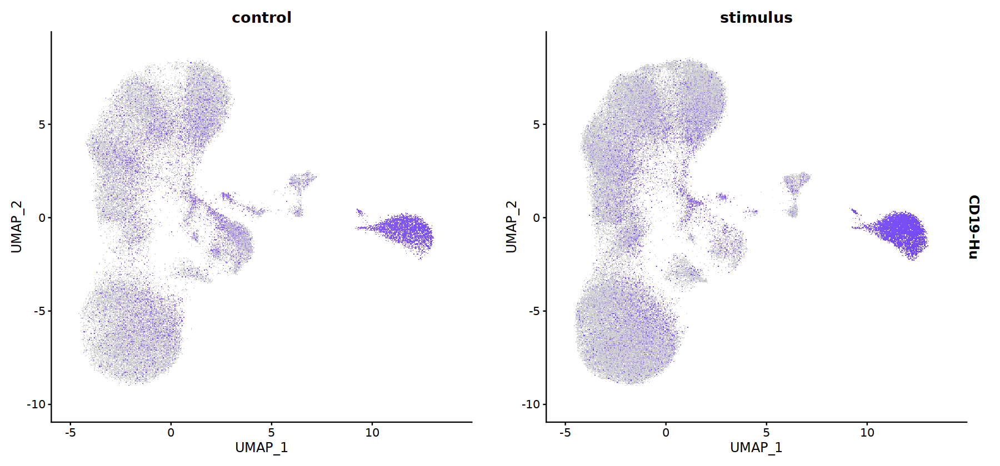

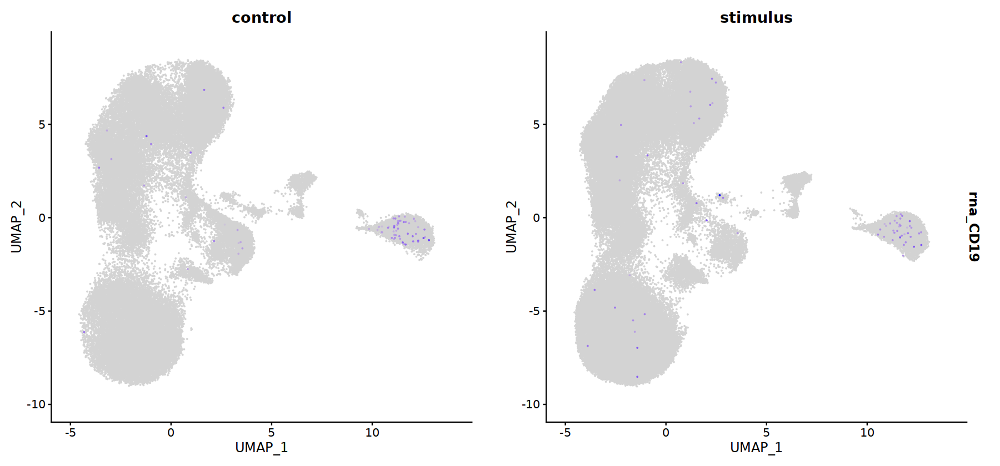

Warning message:
“Could not find FCER2 in the default search locations, found in RNA assay instead”


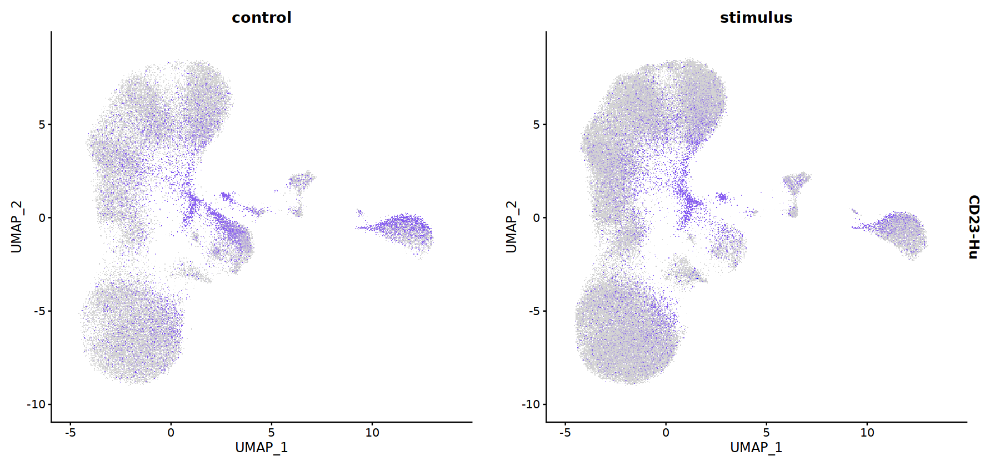

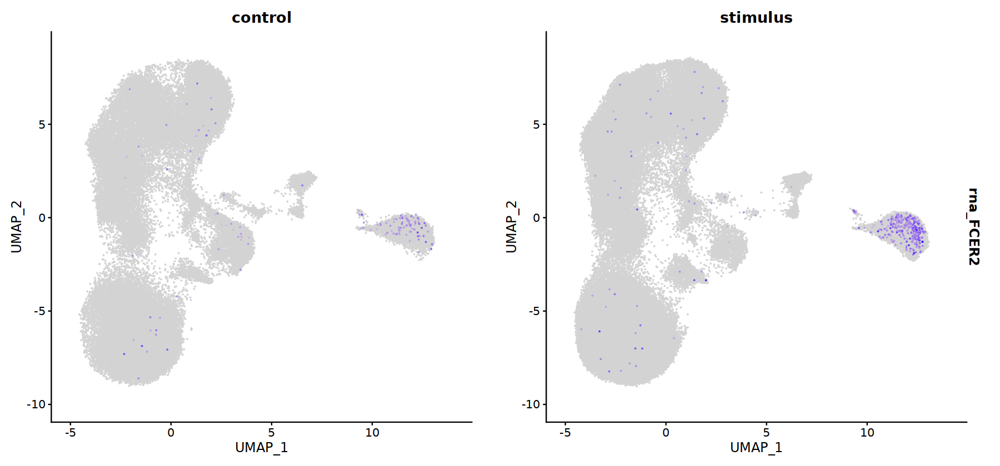

In [96]:
FeaturePlot(mer,"CD19-Hu",split.by="conditions",raster=T,order=F)
FeaturePlot(mer,"CD19",split.by="conditions",raster=F,order=T)
FeaturePlot(mer,"CD23-Hu",split.by="conditions",raster=T,order=F)
FeaturePlot(mer,"FCER2",split.by="conditions",raster=F,order=T)

In [2]:
library(Seurat)
mer=readRDS("/data/work/Analysis/clean_protein_harmony.rds")
setwd("/data/work/Analysis/")

In [2]:
library(future)
plan("multicore",workers = 8)

In [3]:
options(future.globals.maxSize=1000000000000000)
mer@active.assay="Protein"
markers3=FindAllMarkers(mer)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15



In [3]:
mer@active.assay="RNA"
markers4=FindAllMarkers(mer)
#mer@active.assay="Protein"

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15



In [67]:
mer$test_clusters=as.character(mer$seurat_clusters)

In [76]:
mer$test_clusters="pbmc"
mer$test_clusters[mer$seurat_clusters %in% c(10,12,13,15)]="tric"

In [68]:
mer$test_clusters[mer$test_clusters%in% c(0,4)]="13_1"

Warning message:
“Could not find CD103-Hu in the default search locations, found in Protein assay instead”


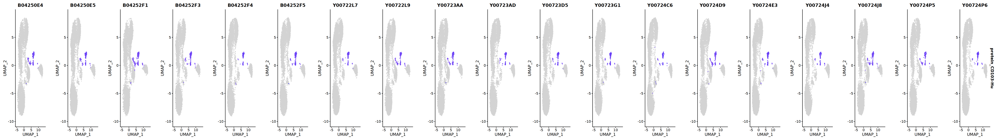

In [107]:
options(repr.plot.width=50)
FeaturePlot(mer,"CD103-Hu",raster=F,order=T,split.by="sample",ncol=3)

In [5]:
saveRDS(markers4,"protein_harmony.RNAmarker.rds")

In [7]:
saveRDS(markers3,"protein_harmony.marker.rds")

In [97]:
saveRDS(mer,"clean_protein_harmony.rds")

In [49]:
markers1=FindAllMarkers(subset(mer,subset=conditions=="control"))
markers2=FindAllMarkers(subset(mer,subset=conditions=="stimulus"))

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20



In [50]:
saveRDS(mer,"protein_harmony.rds")
saveRDS(markers1,"control.marker.rds")
saveRDS(markers2,"stimulus.marker.rds")

In [4]:
markers1=readRDS("control.marker.rds")
markers2=readRDS("stimulus.marker.rds")

In [ ]:
markers2$num=1:nrow(markers2)
df=markers2[markers2$avg_log2FC>0,]
test=df %>% group_by(cluster) %>% top_n(10,wt=-num)
split(test$gene,test$cluster)

markers1$num=1:nrow(markers1)
df=markers1[markers1$avg_log2FC>0,]
test=df %>% group_by(cluster) %>% top_n(10,wt=-num)
split(test$gene,test$cluster)

In [7]:
mer=readRDS("/data/work/Analysis/protein_harmony.rds")

In [114]:
df[df$Gene.Name=="",]

,PIDSequence,PIDIndex,PIDName,GeneName,Description,Clone,Ensembl.ID,Gene.Name,PIDName1
,<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
Isotype-Rat-IgG2ak,AAGTCAGGTTCGTTT,6,Isotype_Rat_IgG2ak,None,"Rat IgG2a, κ Isotype Ctrl",RTK2758,,,Isotype-Rat-IgG2ak
Isotype-Ms-IgG2bk,ATATGTATCACGCGA,2,Isotype_Ms_IgG2bk,None,"Mouse IgG2b, κ isotype Ctrl",MPC-11,,,Isotype-Ms-IgG2bk
Isotype-Rat-IgG1k,ATCAGATGCCCTCAT,4,Isotype_Rat_IgG1k,None,"Rat IgG1, κ isotype Ctrl",RTK2071,,,Isotype-Rat-IgG1k
Ig-light-chain-l-Hu,CAGCCAGTAAGTCAC,217,Ig_light_chain_l_Hu,IGLC2,anti-human Ig light chain λ,MHL-38,,,Ig-light-chain-l-Hu
Isotype-Ham-IgG,CCTGTCATTAAGACT,8,Isotype_Ham_IgG,None,Armenian Hamster IgG Isotype Ctrl,HTK888,,,Isotype-Ham-IgG
TCR-a-b-Hu,CGTAACGTAGAGCGA,240,TCR_a_b_Hu,TRA,anti-human TCR α/β,IP26,,,TCR-a-b-Hu
Isotype-Ms-IgG2ak,CTCCTACCTAAACTG,1,Isotype_Ms_IgG2ak,None,"Mouse IgG2a, κ isotype Ctrl",MOPC-173,,,Isotype-Ms-IgG2ak
Isotype-Rat-IgG2bk,GATTCTTGACGACCT,3,Isotype_Rat_IgG2bk,None,"Rat IgG2b, κ Isotype Ctrl",RTK4530,,,Isotype-Rat-IgG2bk
Isotype-Ms-IgG1k,GCCGGACGACATTAA,0,Isotype_Ms_IgG1k,None,"Mouse IgG1, κ isotype Ctrl",MOPC-21,,,Isotype-Ms-IgG1k


In [111]:
barcode=read.table("ProteinBarcodes476_V1.txt",header=T)
totalseq=read.table("Totalseq.list",sep="\t",header=T,quote="\"")
df=merge(barcode,totalseq,by.x="PIDSequence",by.y="Barcode")
df$PIDName1=gsub("_","-",df$PIDName)
rownames(df)=df$PIDName1

#df[df$PIDName1 =="Ig-light-chain-l-Hu",]

In [ ]:
#mer=readRDS("filter.merge.rds")
#features <- SelectIntegrationFeatures(object.list = SplitObject(mer,split.by="sample"))
options(future.globals.maxSize=10000000000000000000)
library(future)
plan("multicore", workers = 10)
anchors <- FindIntegrationAnchors(object.list = SplitObject(mer,split.by="sample"), anchor.features = features)
plan("multicore", workers = 1)
obj.combined <- IntegrateData(anchorset = anchors)
obj.combined <- ScaleData(obj.combined, verbose = FALSE)
obj.combined=RunPCA(obj.combined)
obj.combined=RunUMAP(obj.combined,dims = 1:15)
obj.combined=FindNeighbors(obj.combined,dims = 1:15)
obj.combined=FindClusters(obj.combined)